In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import os, glob, pickle
import json
import matplotlib.pyplot as plt
import libstempo as t2
from enterprise.signals import utils
from enterprise import constants as const
from h5pulsar import Pulsar, FilePulsar
#from enterprise.pulsar import Pulsar
import IPTA_DR2_analysis.utils as dr2u

In [3]:
%matplotlib inline
%config IPython.matplotlib.backend = "retina"
from matplotlib import rcParams
rcParams["savefig.dpi"] = 300
rcParams["figure.dpi"] = 300

Use this notebook for the following datasets:
- Lite unfiltered (53)
- Lite unfiltered (43)
- Lite unfiltered (21)
- Lite (filtered)
- Lite refit (filtered)

In [12]:
project_path = '/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis'
#datadir = '/vast/palmer/home.grace/bbl29/DR2/release/VersionB'
savedir = f'{project_path}/data/lite_unfiltered_53_ePSRs'
datadir = f'{project_path}/data/lite_unfiltered_partim_final_hotfix_sw'
figsave = f'{project_path}/figs/dr2lite_unfiltered_53/resids'

In [11]:
# this is to hotfix the SW to ensure it varies by default
if False:
    for parfile in glob.glob(f'{datadir}/*.par'):
        print(parfile.split('/')[-1])
        with open(parfile, 'r') as f:
            txt = f.read()
        oldline = 'NE_SW          4                          '
        newline = 'NE_SW          4                         1'
        txt = txt.replace(oldline,newline)
        new_parfile = parfile.replace('lite_unfiltered_partim_final', 'lite_unfiltered_partim_final_hotfix_sw')
        with open(new_parfile, 'w') as f:
            f.write(txt)

J0030+0451.par
J0034-0534.par
J0218+4232.par
J0437-4715.par
J0610-2100.par
J0613-0200.par
J0621+1002.par
J0711-6830.par
J0751+1807.par
J0900-3144.par
J1012+5307.par
J1022+1001.par
J1024-0719.par
J1045-4509.par
J1455-3330.par
J1600-3053.par
J1603-7202.par
J1614-2230.par
J1640+2224.par
J1643-1224.par
J1713+0747.par
J1721-2457.par
J1730-2304.par
J1732-5049.par
J1738+0333.par
J1741+1351.par
J1744-1134.par
J1751-2857.par
J1801-1417.par
J1802-2124.par
J1804-2717.par
J1824-2452A.par
J1843-1113.par
J1853+1303.par
J1857+0943.par
J1903+0327.par
J1909-3744.par
J1910+1256.par
J1911+1347.par
J1911-1114.par
J1918-0642.par
J1939+2134.par
J1944+0907.par
J1955+2908.par
J2010-1323.par
J2019+2425.par
J2033+1734.par
J2124-3358.par
J2129-5721.par
J2145-0750.par
J2229+2643.par
J2317+1439.par
J2322+2057.par


In [13]:
psrlist = []
psrs = glob.glob(datadir + '/J*')
for psr in psrs:
    name = psr.split('/')[-1][:-4]
    psrlist.append(name)
psrlist = np.sort(np.unique(psrlist))
psrlist, len(psrlist)

(array(['J0030+0451', 'J0034-0534', 'J0218+4232', 'J0437-4715',
        'J0610-2100', 'J0613-0200', 'J0621+1002', 'J0711-6830',
        'J0751+1807', 'J0900-3144', 'J1012+5307', 'J1022+1001',
        'J1024-0719', 'J1045-4509', 'J1455-3330', 'J1600-3053',
        'J1603-7202', 'J1614-2230', 'J1640+2224', 'J1643-1224',
        'J1713+0747', 'J1721-2457', 'J1730-2304', 'J1732-5049',
        'J1738+0333', 'J1741+1351', 'J1744-1134', 'J1751-2857',
        'J1801-1417', 'J1802-2124', 'J1804-2717', 'J1824-2452A',
        'J1843-1113', 'J1853+1303', 'J1857+0943', 'J1903+0327',
        'J1909-3744', 'J1910+1256', 'J1911+1347', 'J1911-1114',
        'J1918-0642', 'J1939+2134', 'J1944+0907', 'J1955+2908',
        'J2010-1323', 'J2019+2425', 'J2033+1734', 'J2124-3358',
        'J2129-5721', 'J2145-0750', 'J2229+2643', 'J2317+1439',
        'J2322+2057'], dtype='<U11'),
 53)

In [14]:
def plot_resids_byfrequency(psr):
    fig, ax = plt.subplots(figsize=(8,4))
    ax.errorbar(psr.toas/const.day, psr.residuals*1e6, yerr=psr.toaerrs*1e6,
                fmt='.k', marker=None, mew=0, alpha=0.5, lw=1, zorder=0)
    sc = ax.scatter(psr.toas/const.day, psr.residuals*1e6, s=5, c=psr.freqs, cmap='Spectral')
    cbar = plt.colorbar(sc)
    cbar.set_label(r"$\nu$ (MHz)")
    ax.set_xlabel("MJD")
    ax.set_ylabel(r"Residual ($\mu s$)")
    ax.grid(linewidth=0.3)
    ax.set_title(psr.name)
    fig.tight_layout()
    plt.show()

In [15]:
def plot_resids_bypta(psr):
    fig, ax = plt.subplots(figsize=(8,4))
    ax.errorbar(psr.toas/const.day, psr.residuals*1e6, yerr=psr.toaerrs*1e6,
                fmt='.k', marker=None, mew=0, alpha=0.5, lw=1, zorder=0)
    for i, pta in enumerate(['NANOGrav','EPTA','PPTA']):
        if pta in psr.flags['pta']:
            mask = psr.flags['pta'] == pta
            sc = ax.scatter(psr.toas[mask]/const.day, psr.residuals[mask]*1e6, s=5,
                            c=f'C{i}', label=pta)
    cbar = plt.colorbar(sc)
    cbar.set_label(r"$\nu$ (MHz)")
    ax.set_xlabel("MJD")
    ax.set_ylabel(r"Residual ($\mu s$)")
    ax.grid(linewidth=0.3)
    ax.set_title(psr.name)
    ax.legend()
    fig.tight_layout()
    plt.show()

In [16]:
def plot_resids(psr, save=None):
    fig, ax = plt.subplots(figsize=(8,4))
    nu_min = np.min(psr.freqs)
    nu_max = np.max(psr.freqs)
    for marker, pta in zip(['s','o','*'], ['NANOGrav','EPTA','PPTA']):
        if pta in psr.flags['pta']:
            mask = psr.flags['pta'] == pta
            ax.errorbar(psr.toas[mask]/const.day, psr.residuals[mask]*1e6, yerr=psr.toaerrs[mask]*1e6,
                        fmt=f'{marker}k', ms=5, marker=None, mew=0, alpha=0.5, lw=1, zorder=0, label=pta)
            sc = ax.scatter(psr.toas[mask]/const.day, psr.residuals[mask]*1e6, s=5, marker=marker,
                            c=psr.freqs[mask], cmap='Spectral', vmin=nu_min, vmax=nu_max)
    cbar = plt.colorbar(sc)
    cbar.set_label(r"$\nu$ (MHz)")
    ax.set_xlabel("MJD")
    ax.set_ylabel(r"Residual ($\mu s$)")
    ax.grid(linewidth=0.3)
    ax.set_title(psr.name)
    ax.legend()
    fig.tight_layout()
    if save:
        fig.savefig(f'{figsave}/{psr.name}.png', dpi=300, bbox_inches='tight')
    plt.show()

In [15]:
if False:
    pfiles = glob.glob(f'/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis/data/lite_ePSRs/J*.hdf5')
    lite_psrs = []
    for file in pfiles:
        lite_psrs.append(FilePulsar(file))
    lite_psrnames = [psr.name for psr in lite_psrs]
    lite_psrnames

In [20]:
savedir

'/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis/data/lite_refit_ePSRs'

J0030+0451


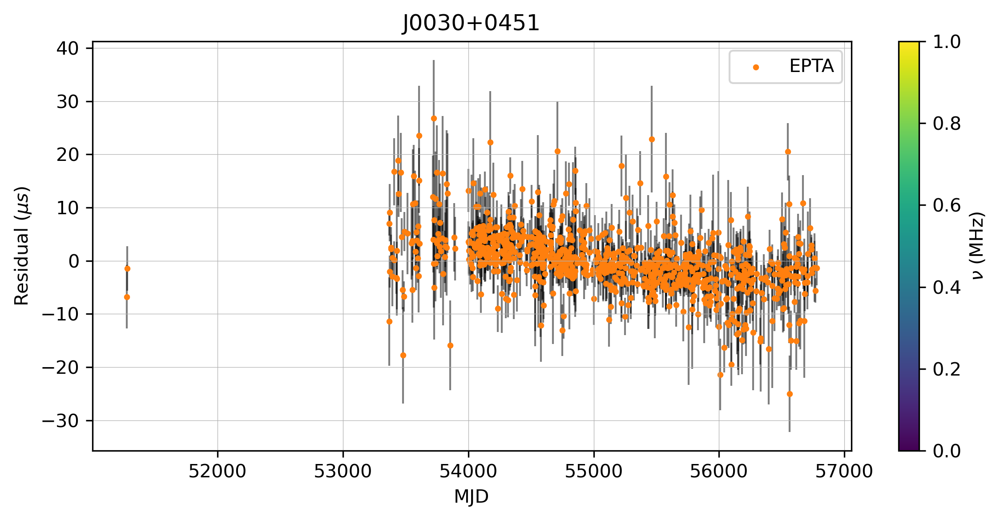

J0034-0534


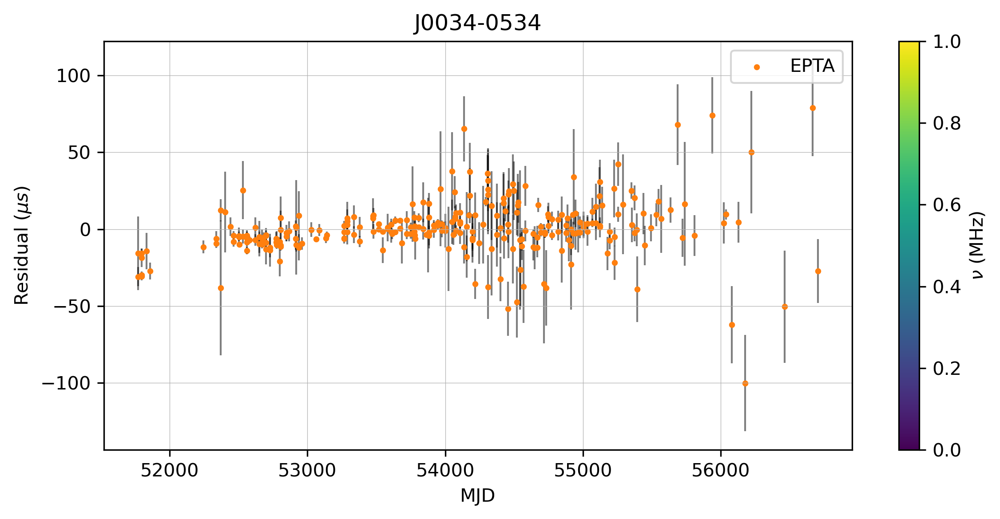

J0218+4232


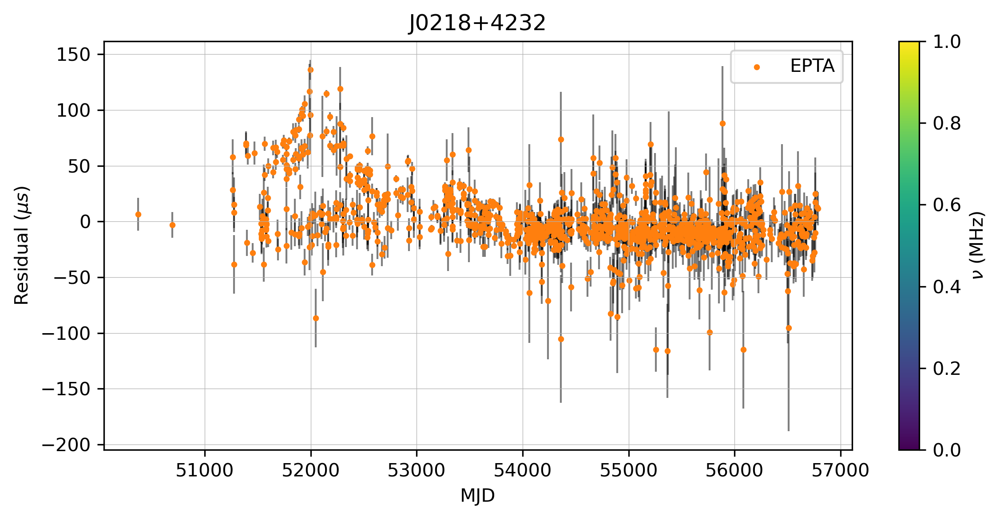

J0437-4715


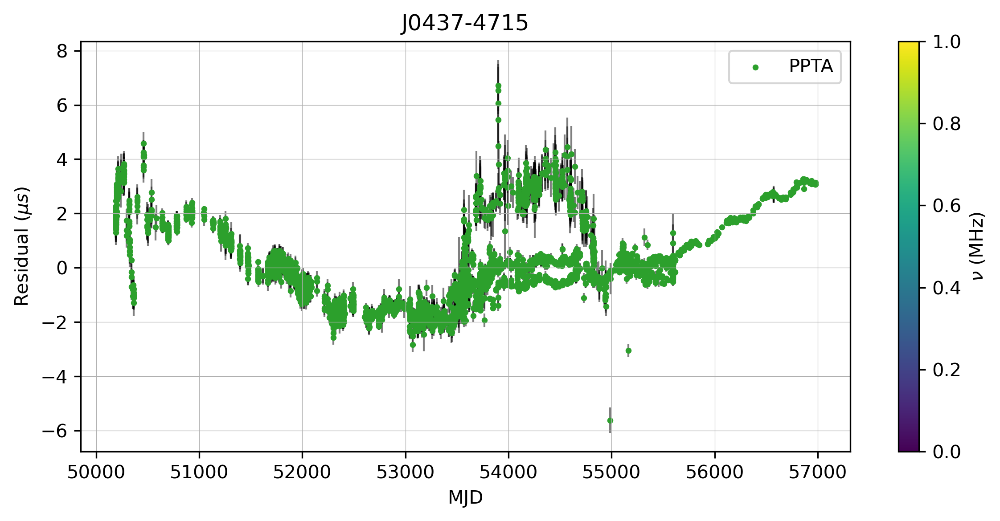

J0610-2100


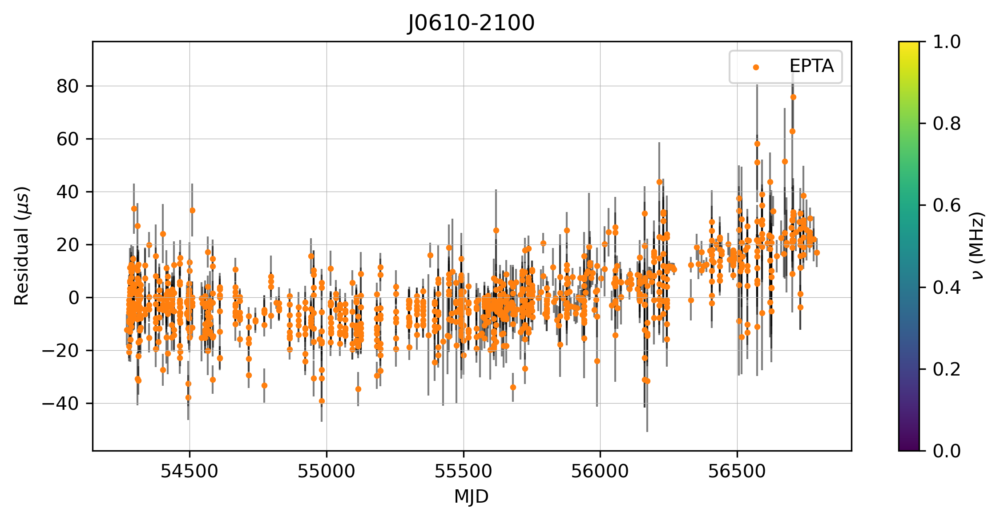

J0613-0200


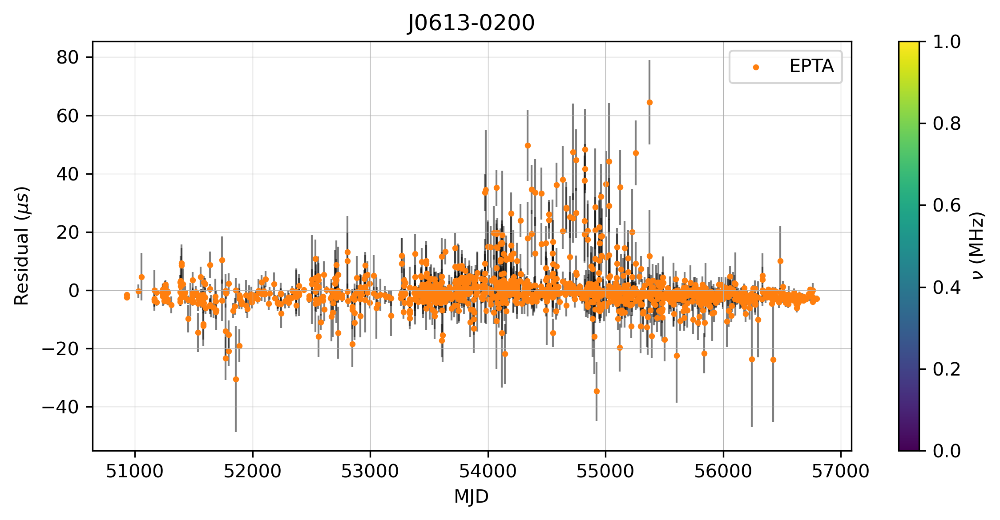

J0621+1002


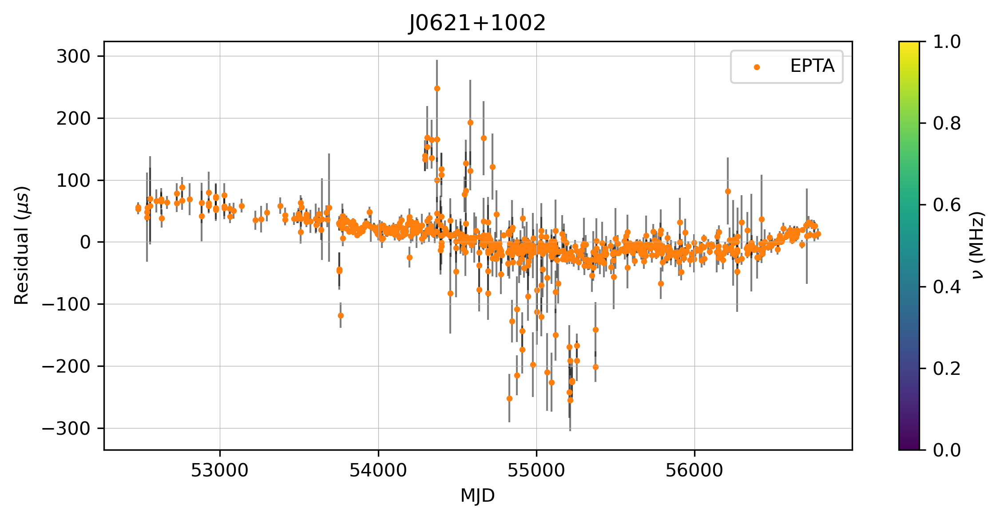

J0711-6830


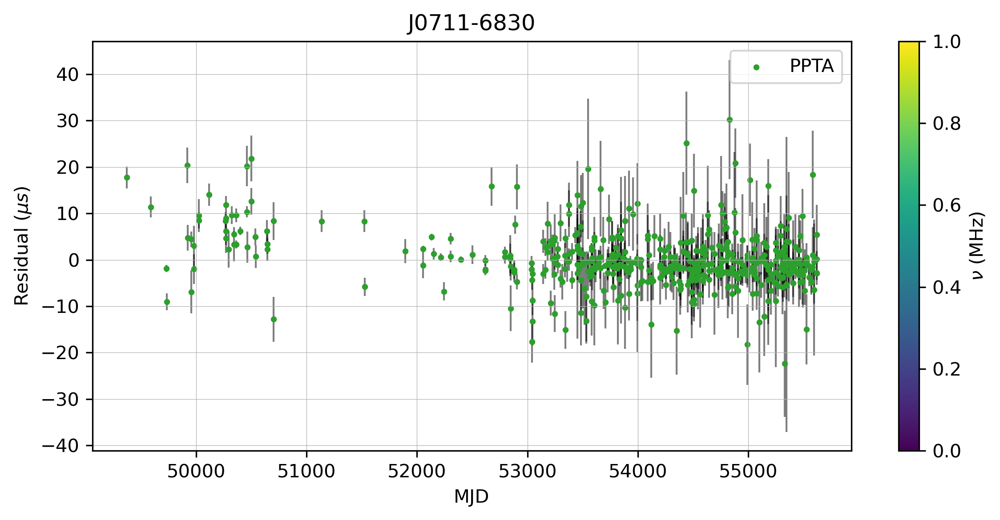

J0751+1807


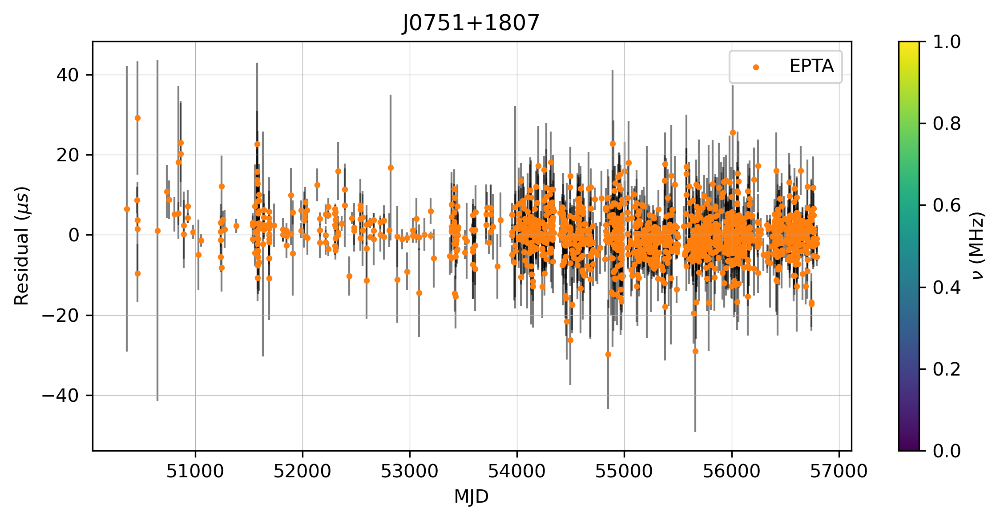

J0900-3144


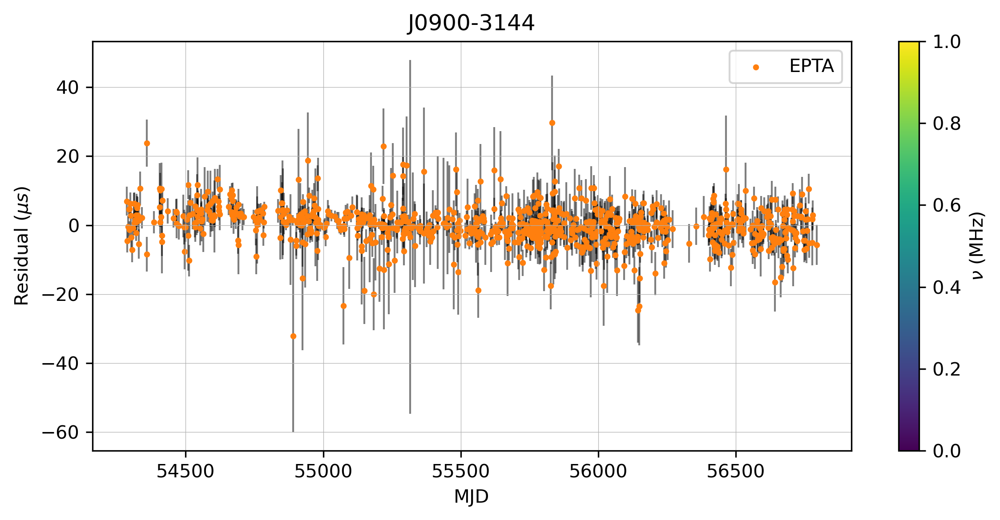

J1012+5307


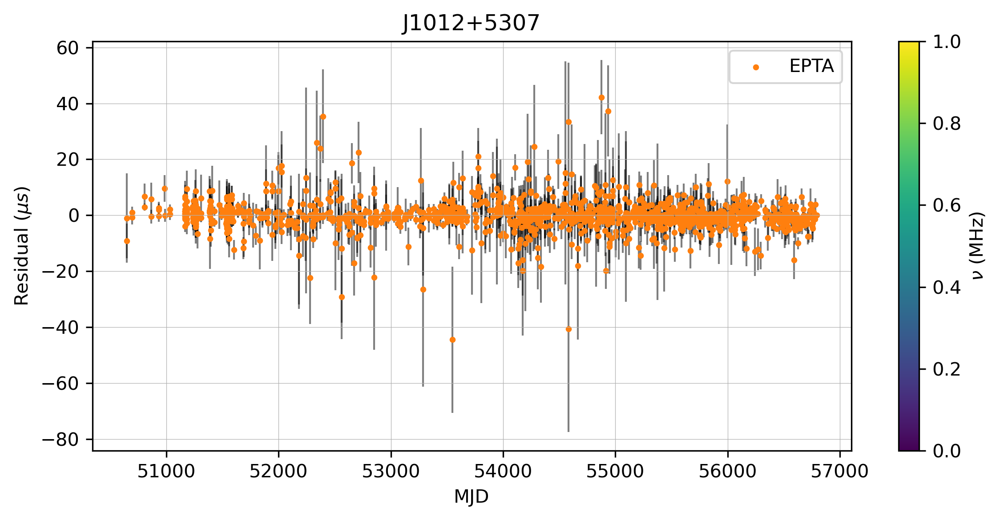

J1022+1001


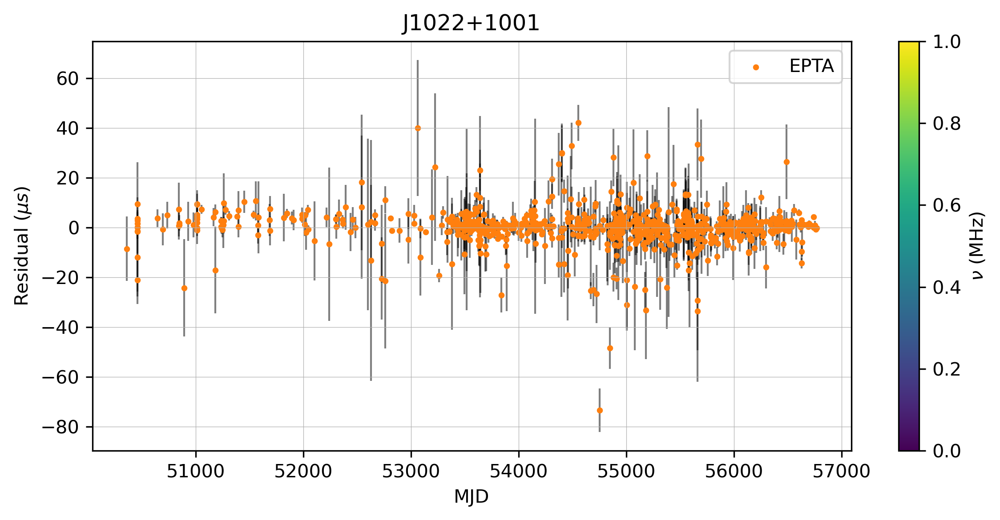

J1024-0719


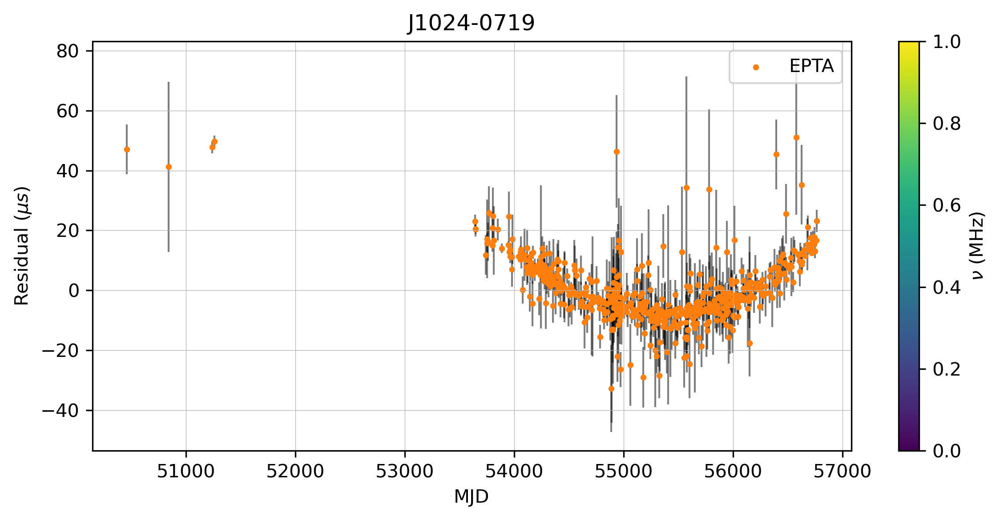

J1045-4509


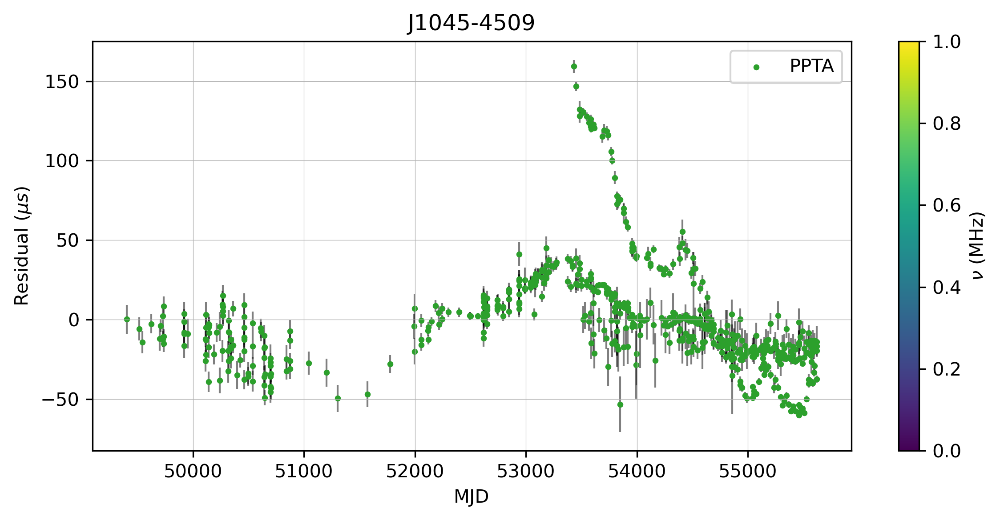

J1455-3330


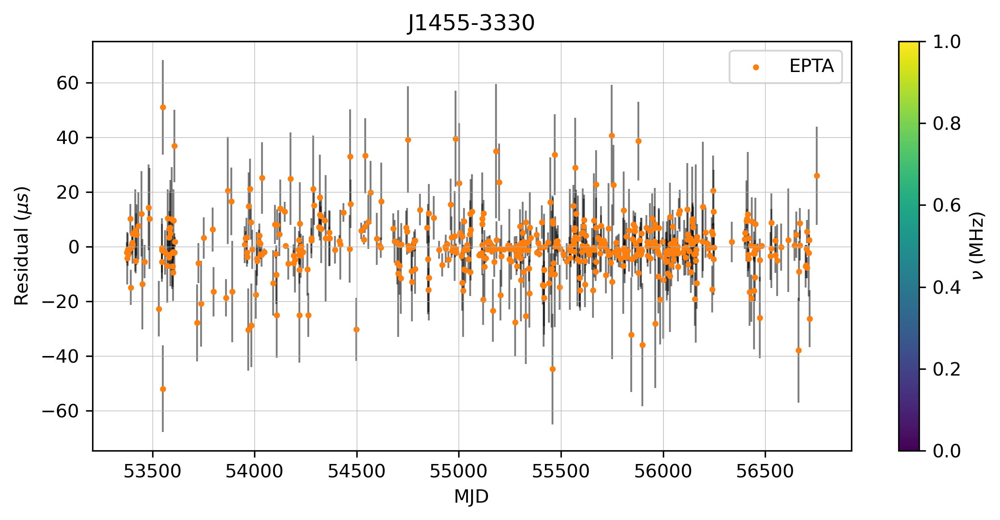

J1600-3053


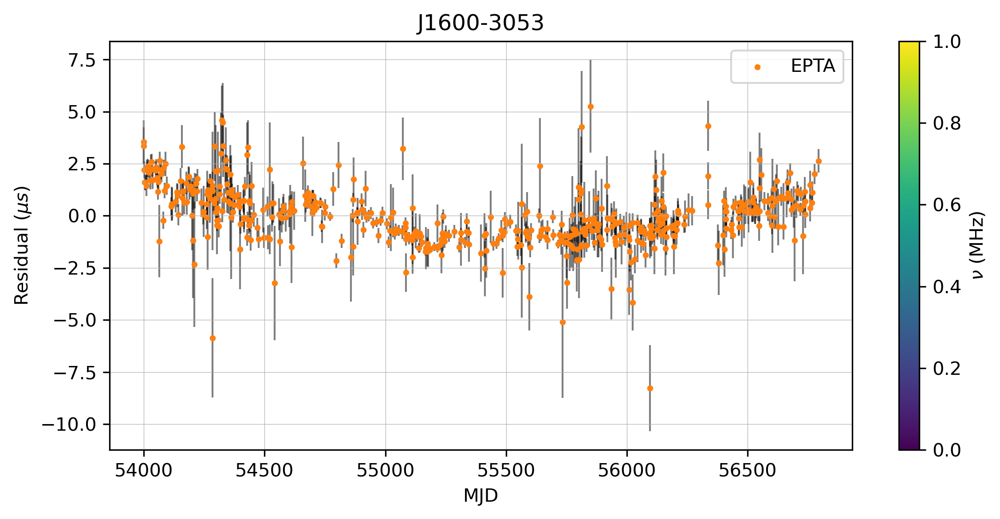

J1603-7202


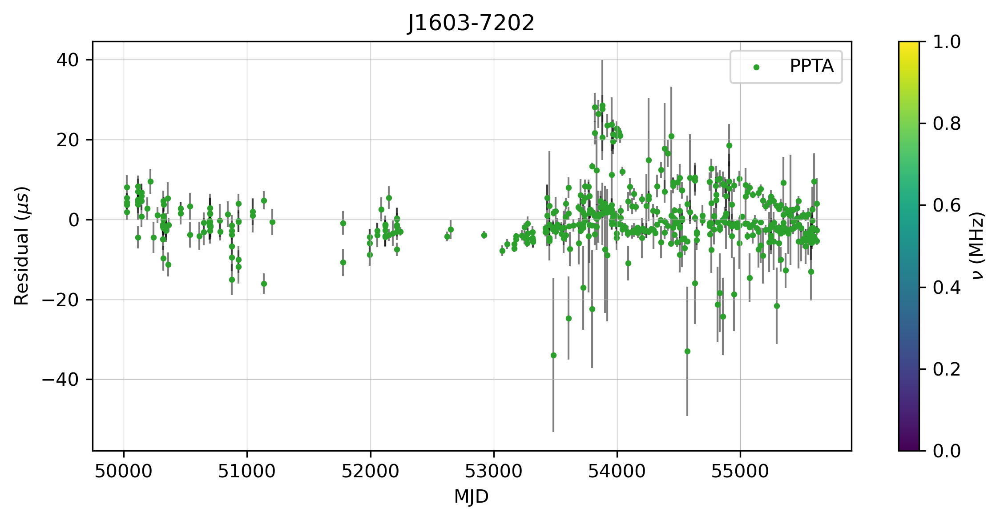

J1614-2230


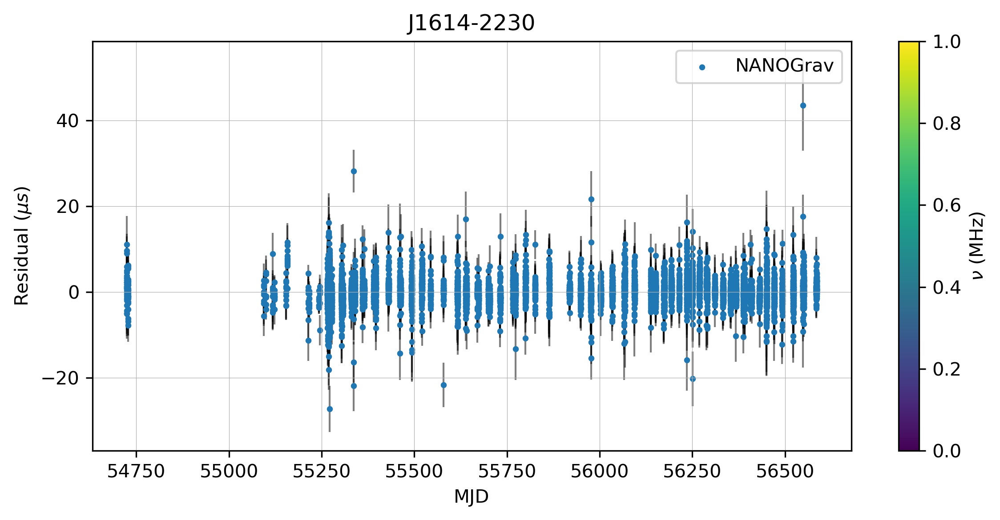

J1640+2224


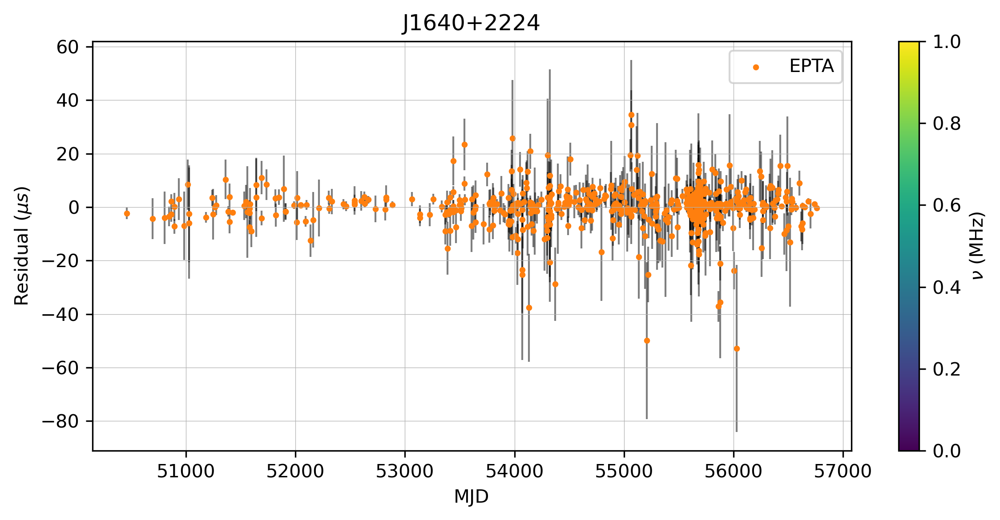

J1643-1224


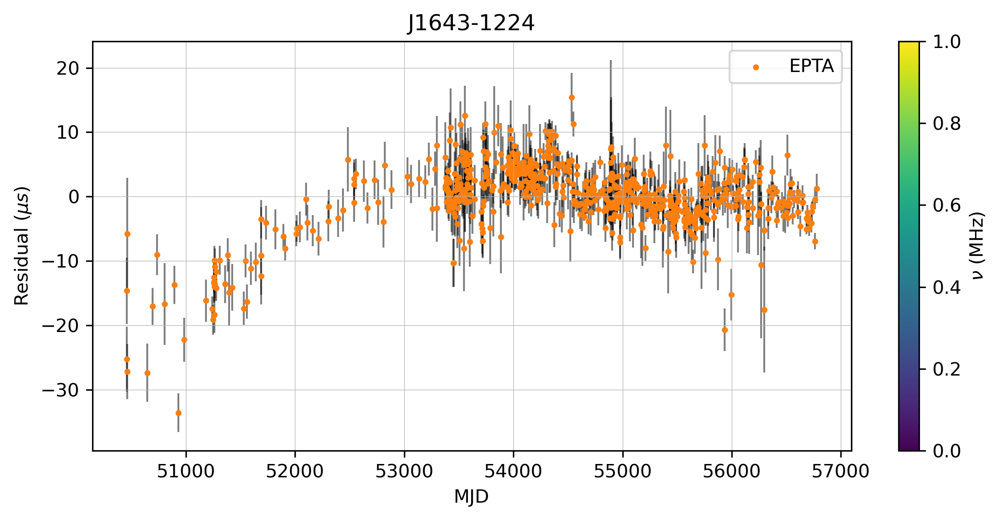

J1713+0747


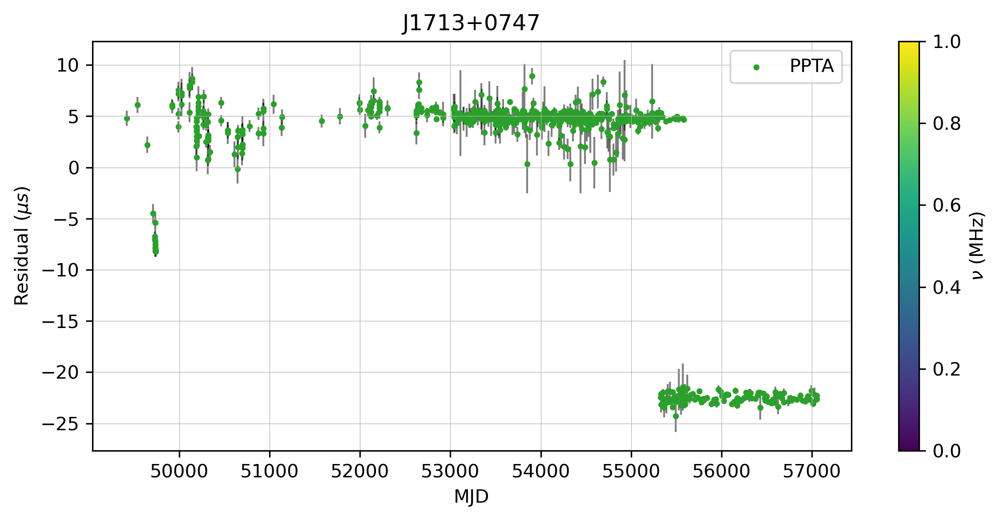

J1721-2457


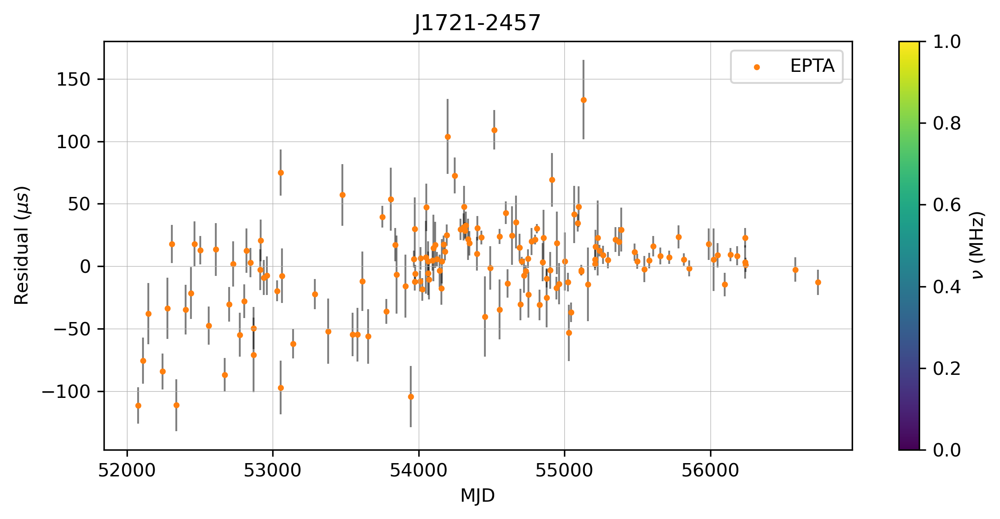

J1730-2304


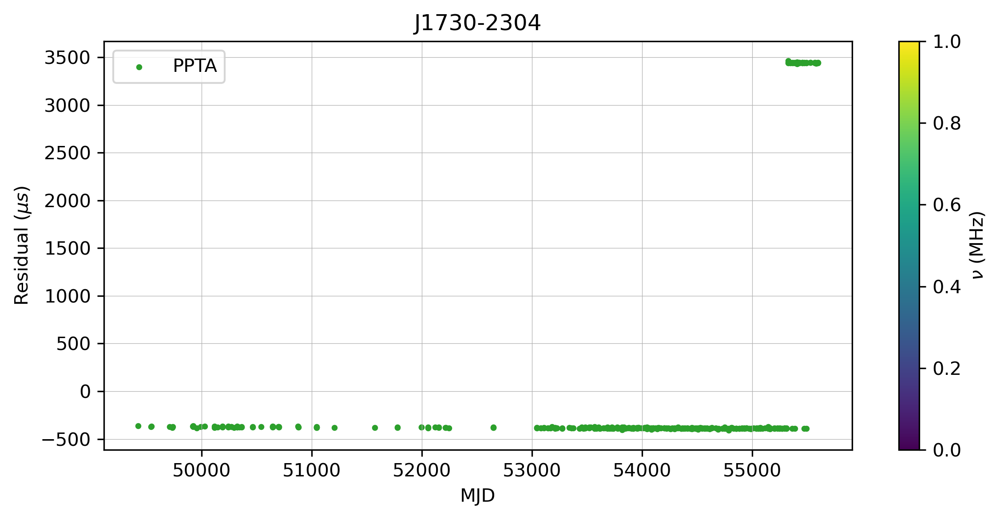

J1732-5049


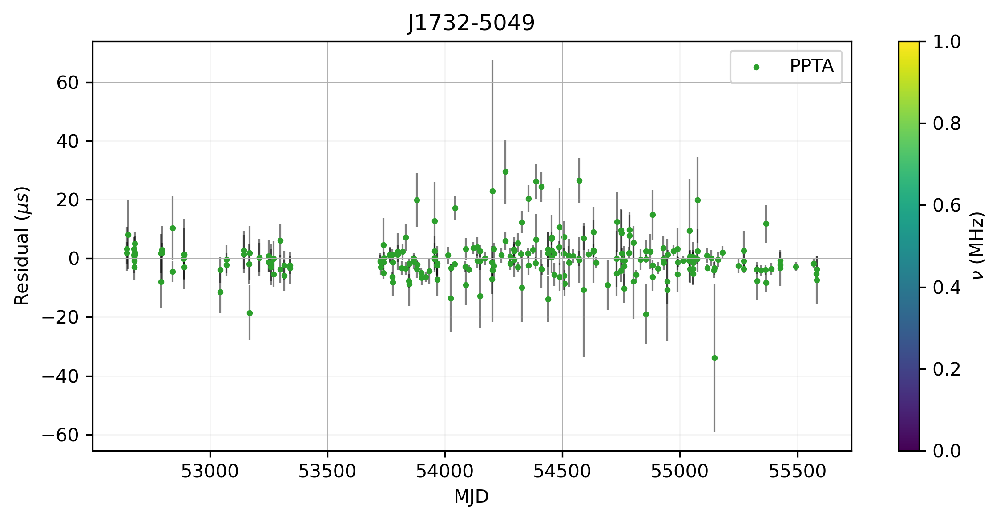

J1738+0333


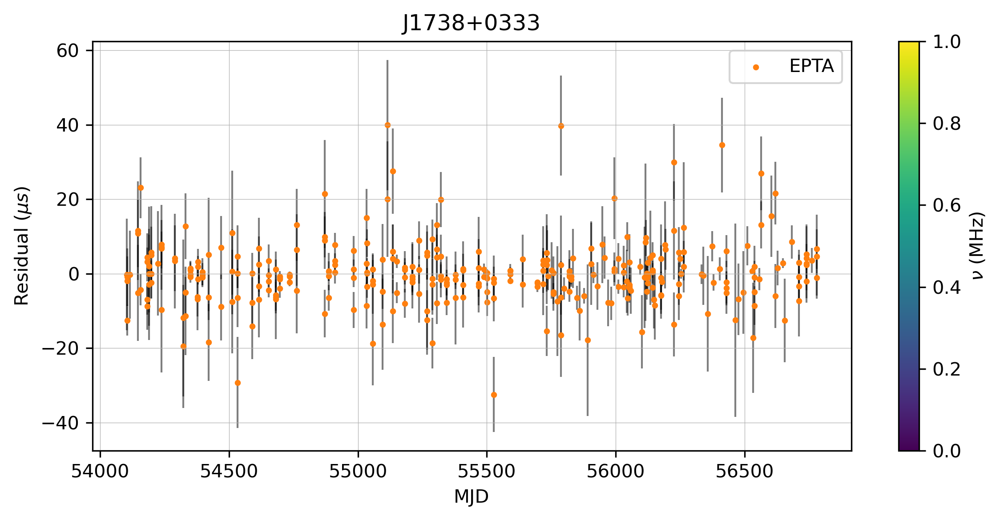

J1741+1351


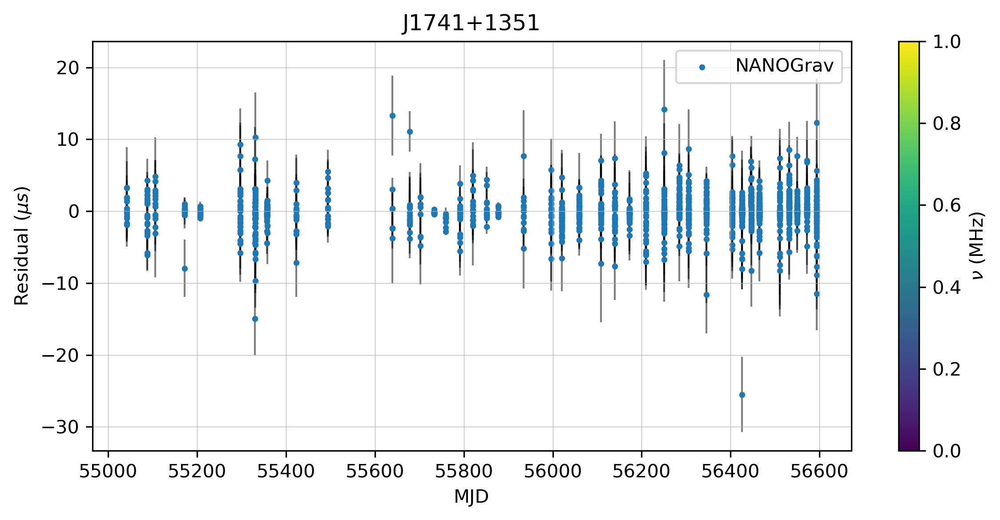

J1744-1134


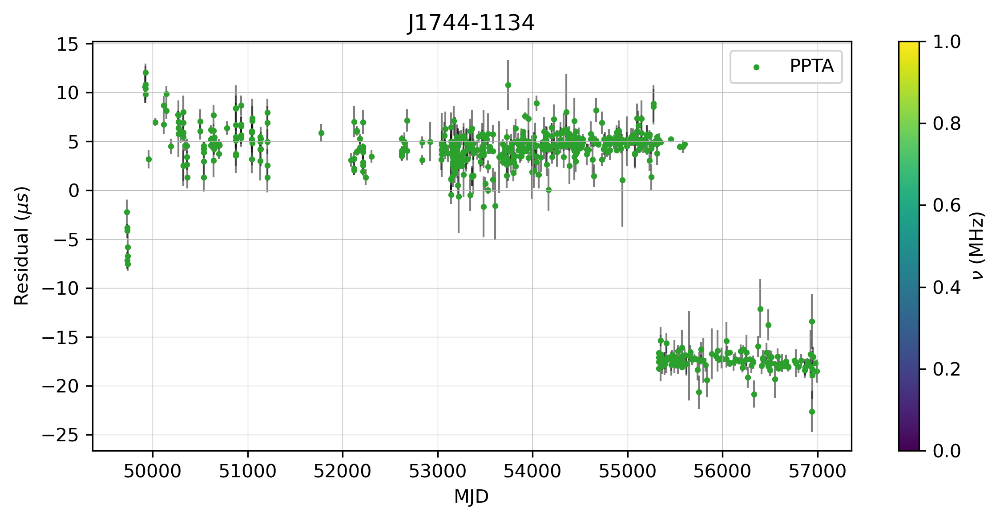

J1751-2857


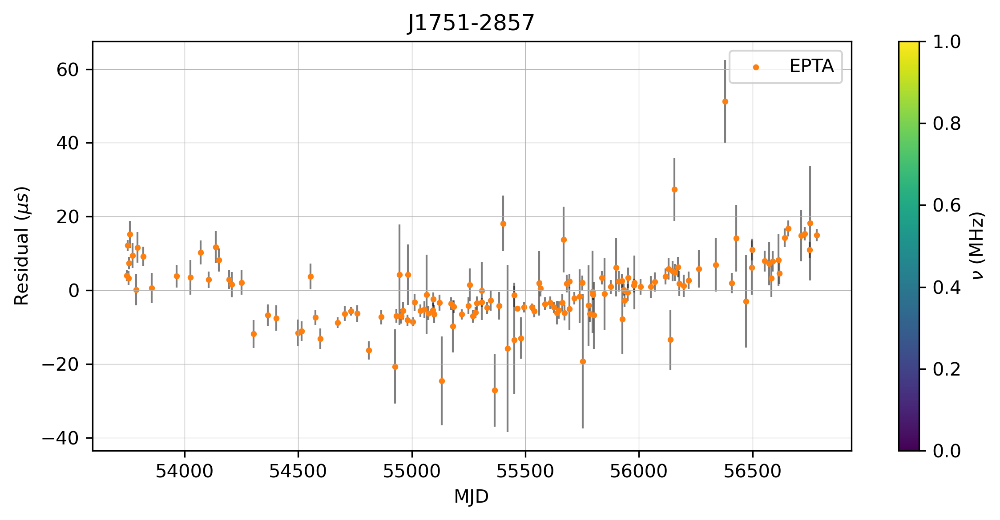

J1801-1417


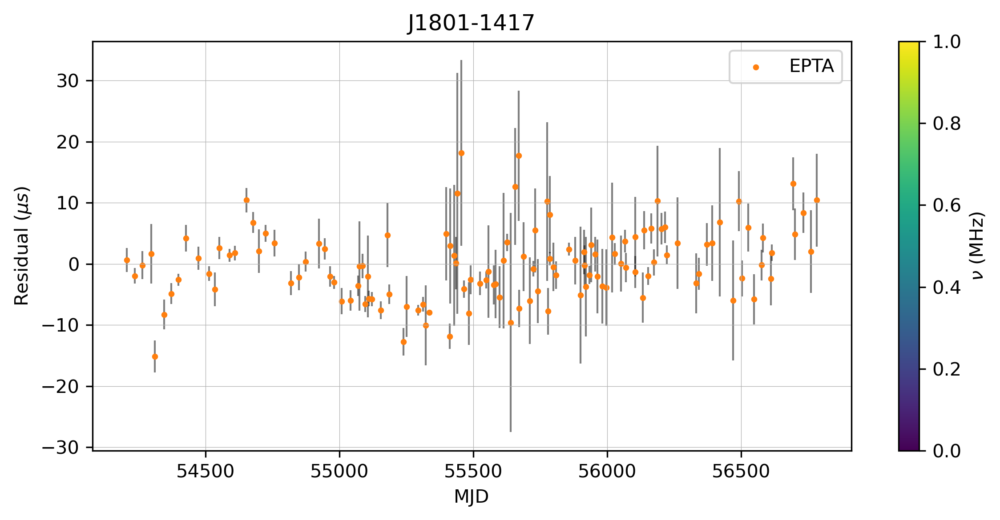

J1802-2124


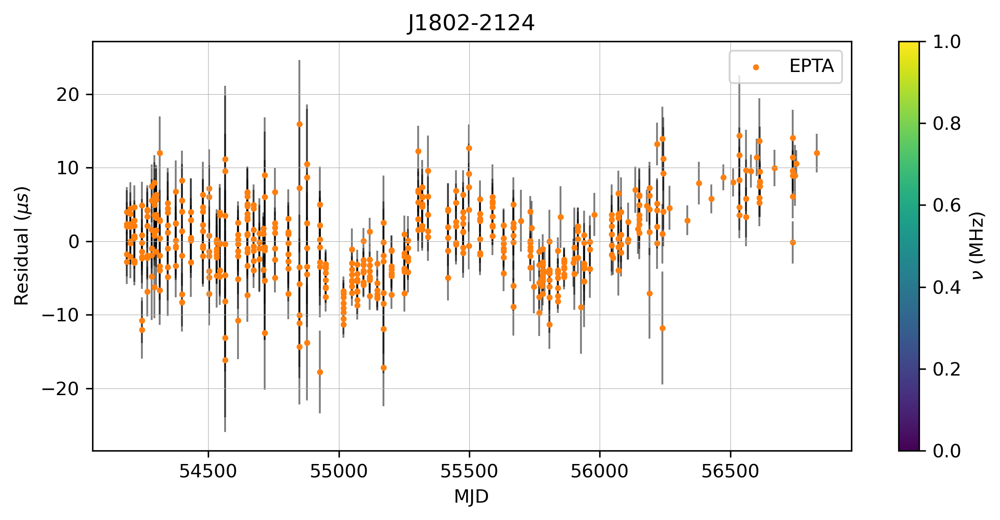

J1804-2717


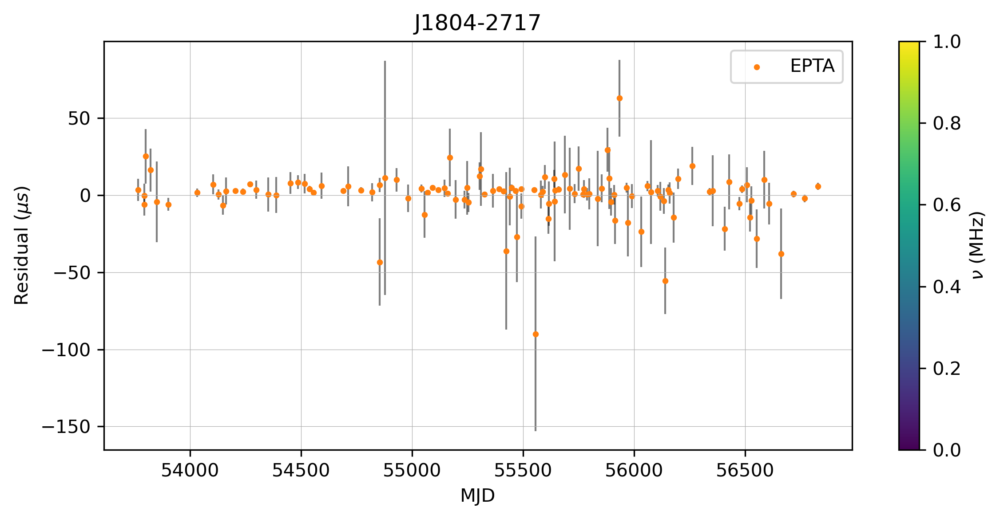

J1824-2452A


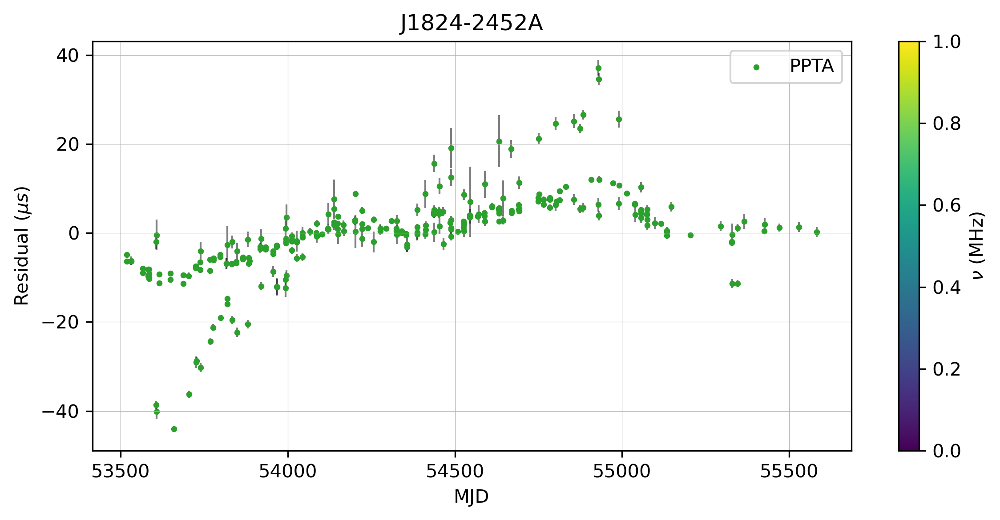

J1843-1113


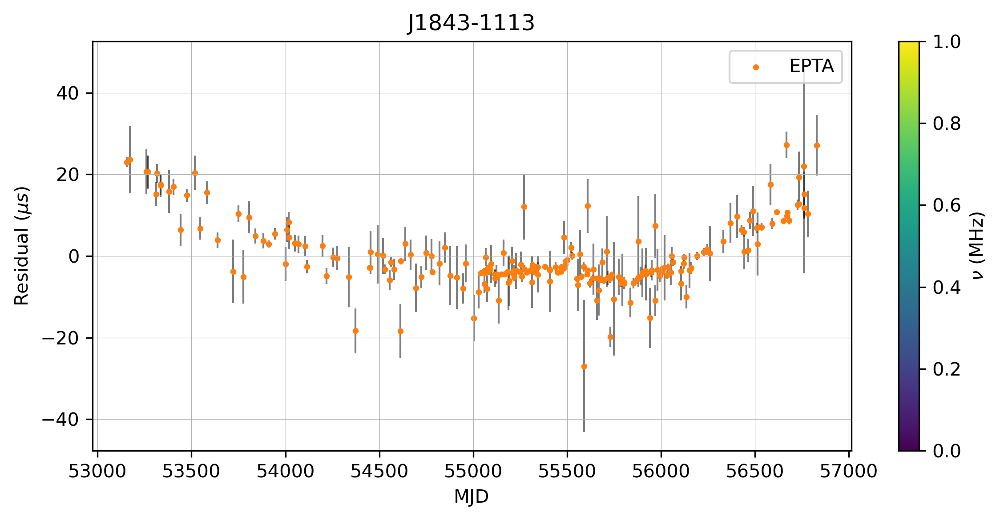

J1853+1303


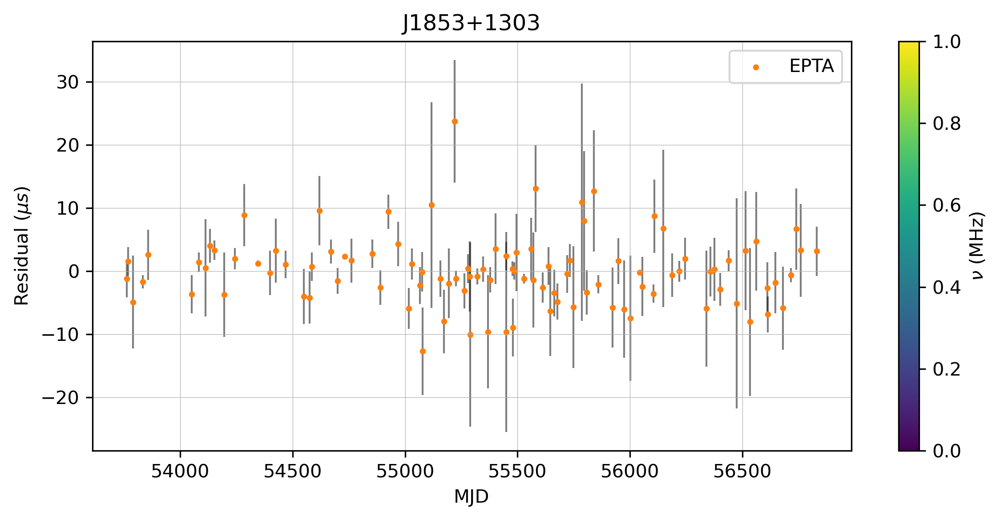

J1857+0943


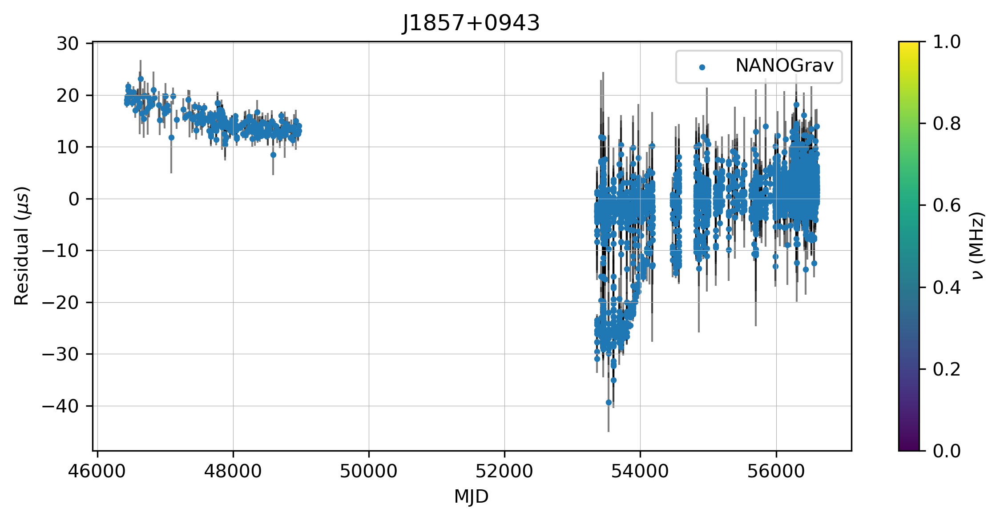

J1903+0327


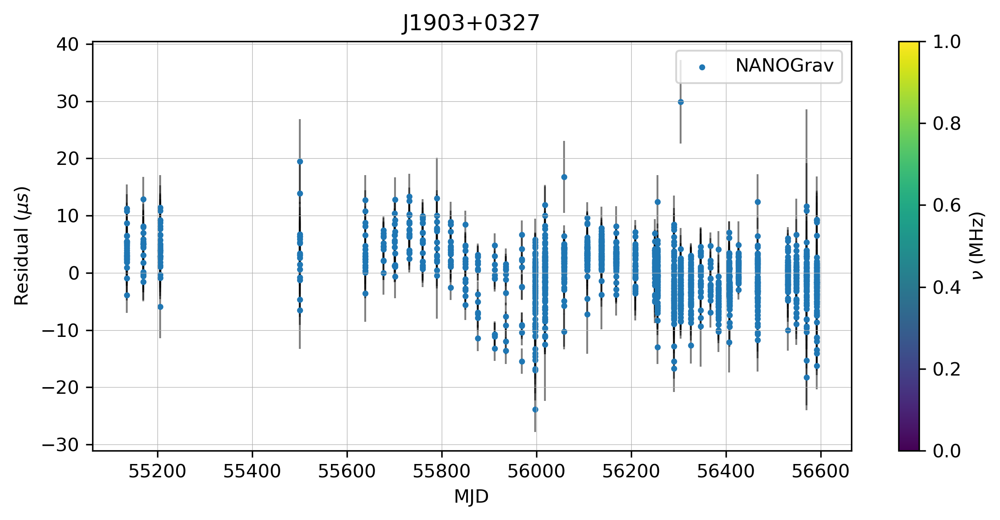

J1909-3744


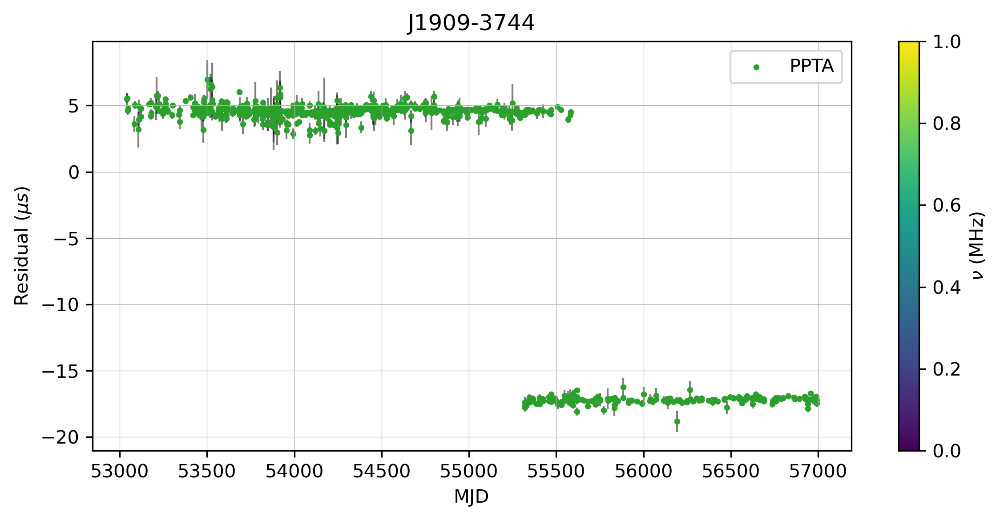

J1910+1256


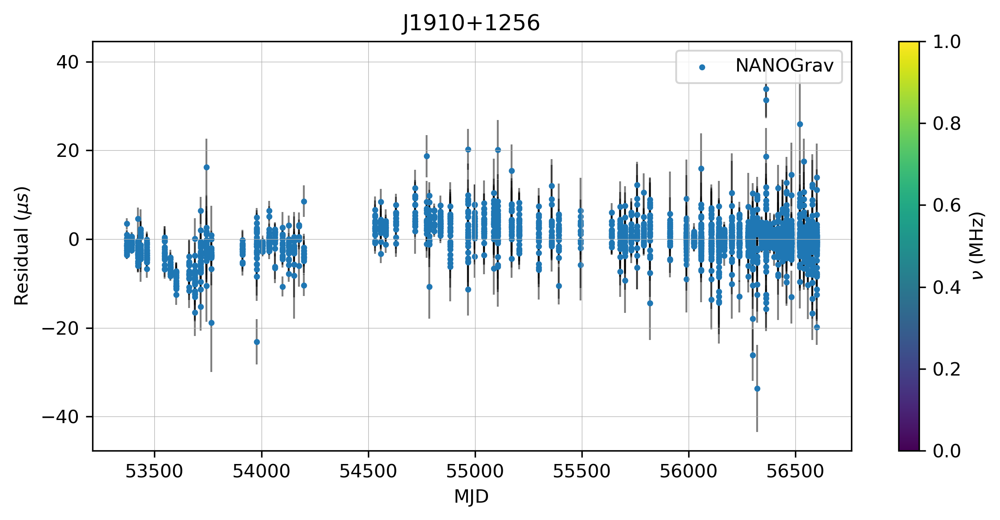

J1911+1347


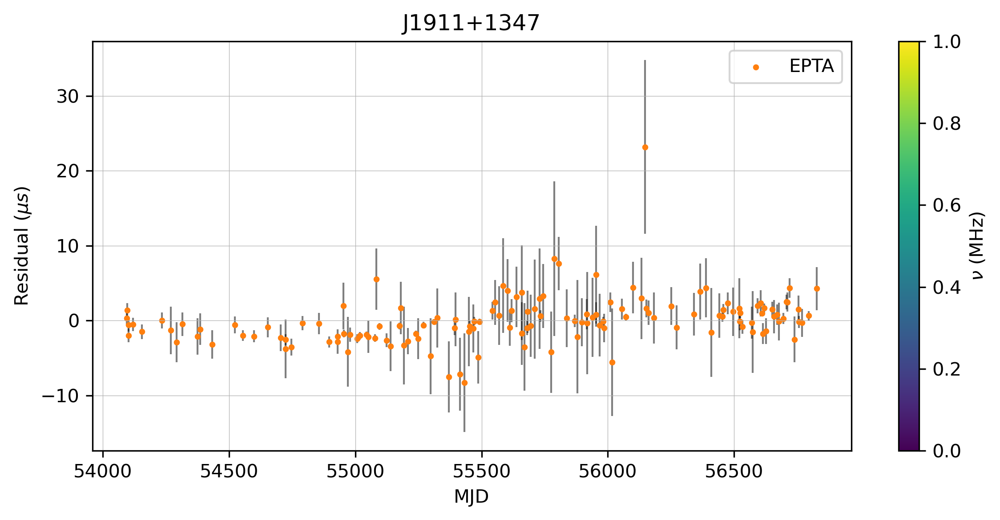

J1911-1114


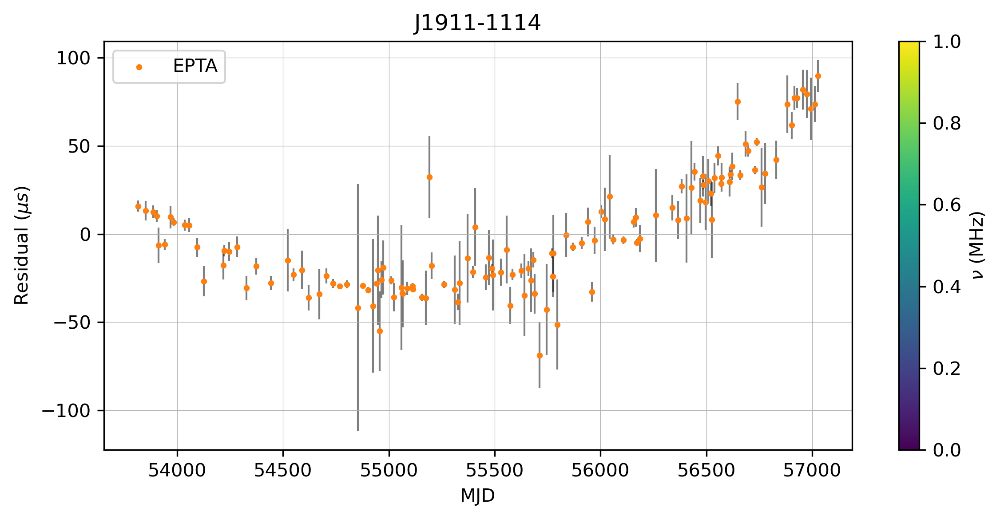

J1918-0642


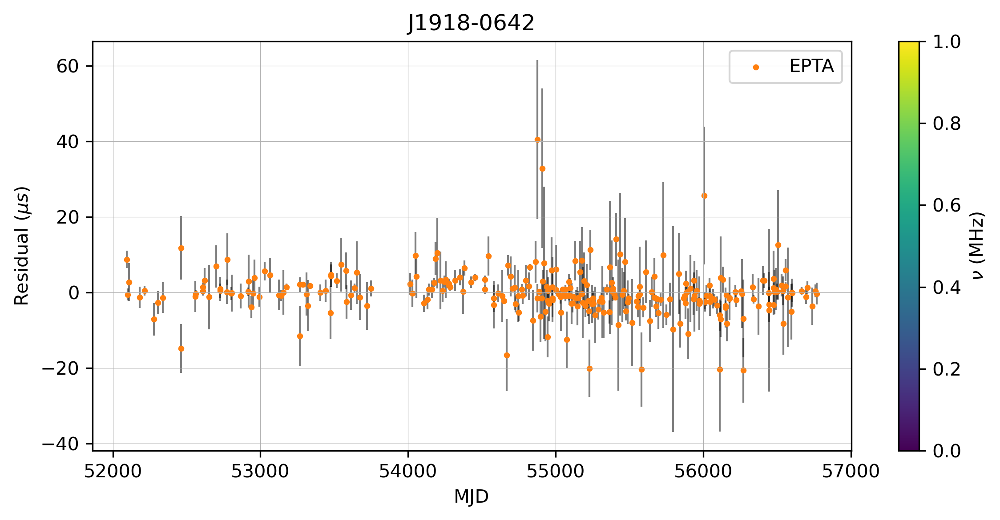

J1939+2134


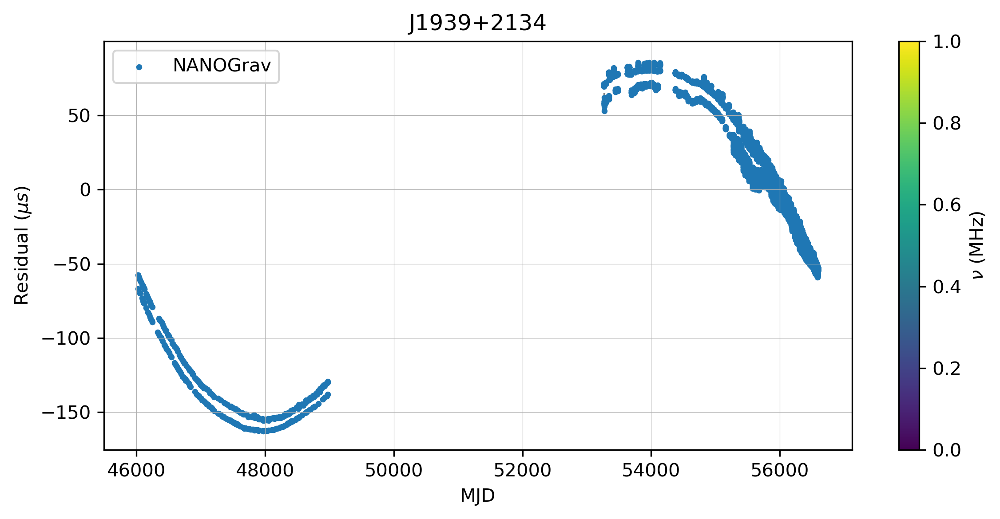

J1944+0907


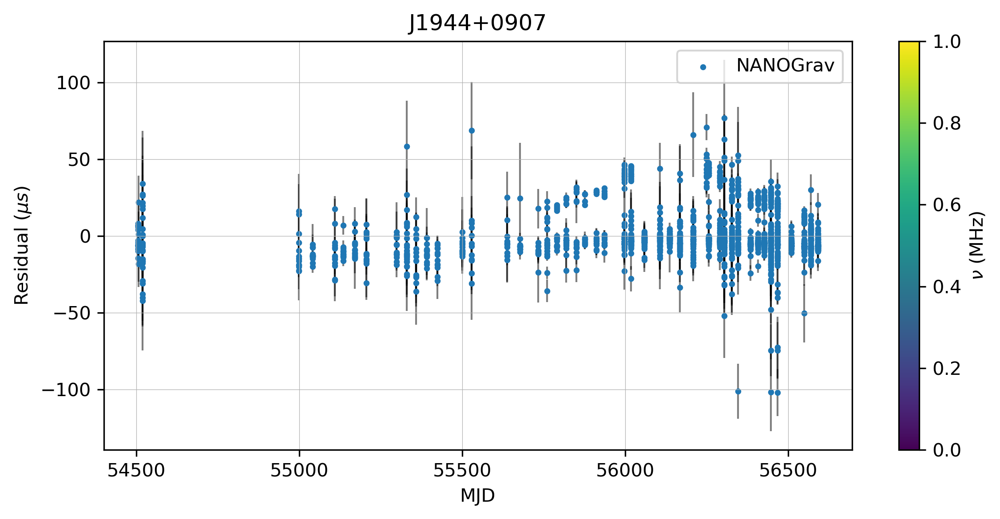

J1955+2908


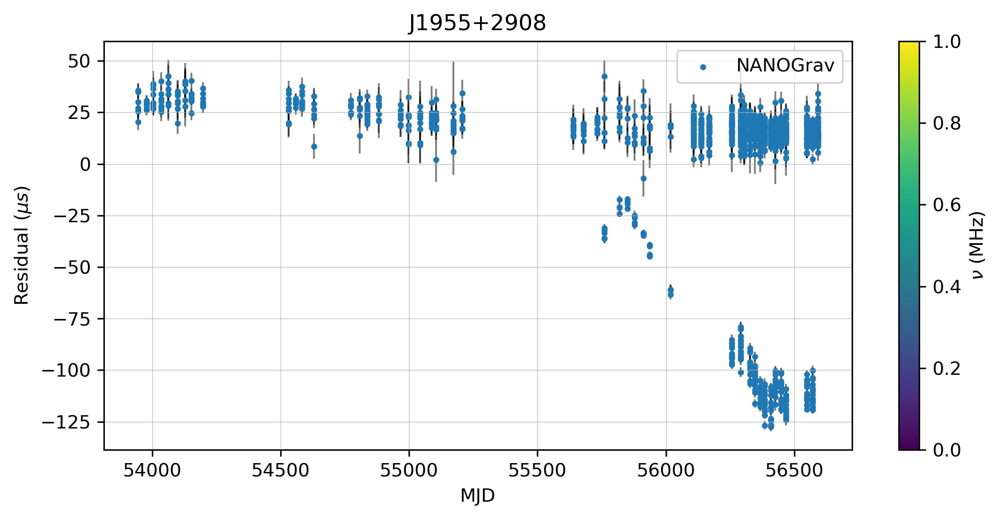

J2010-1323


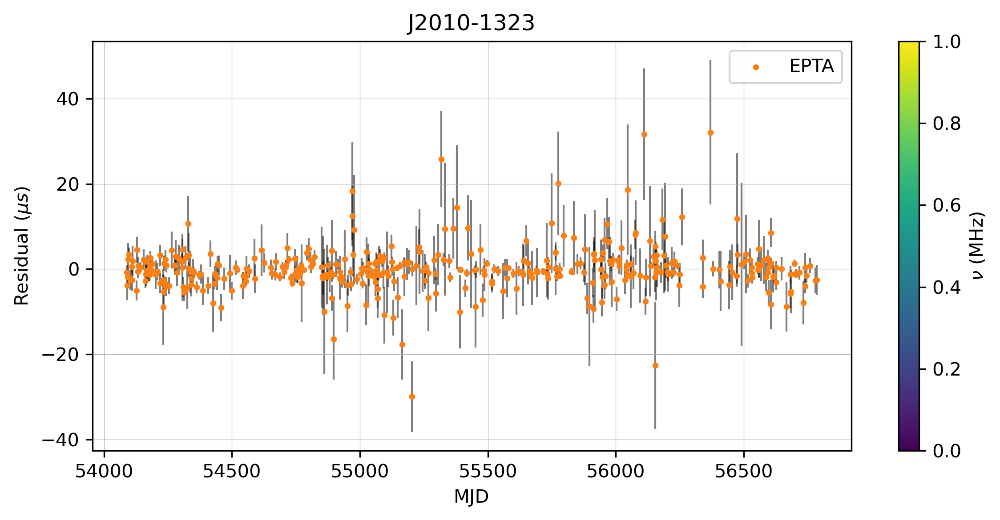

J2019+2425


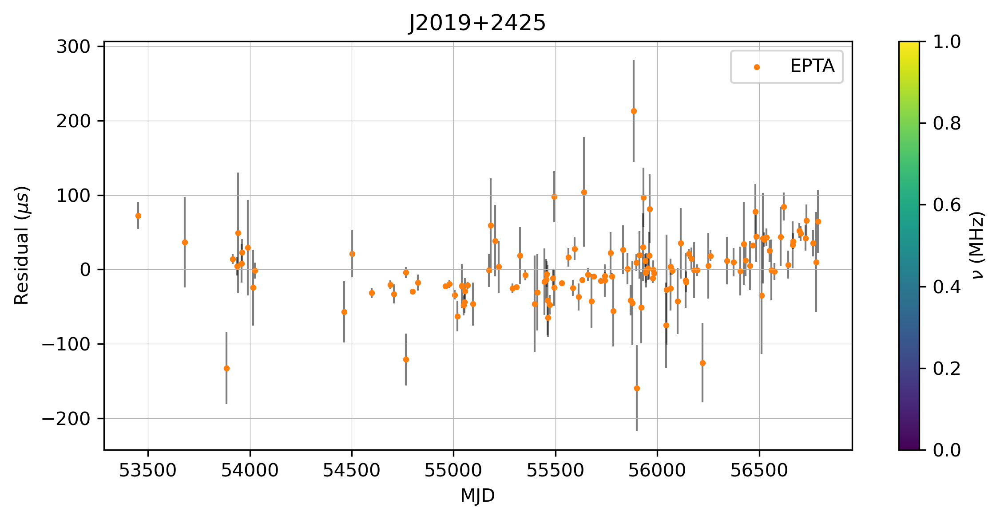

J2033+1734


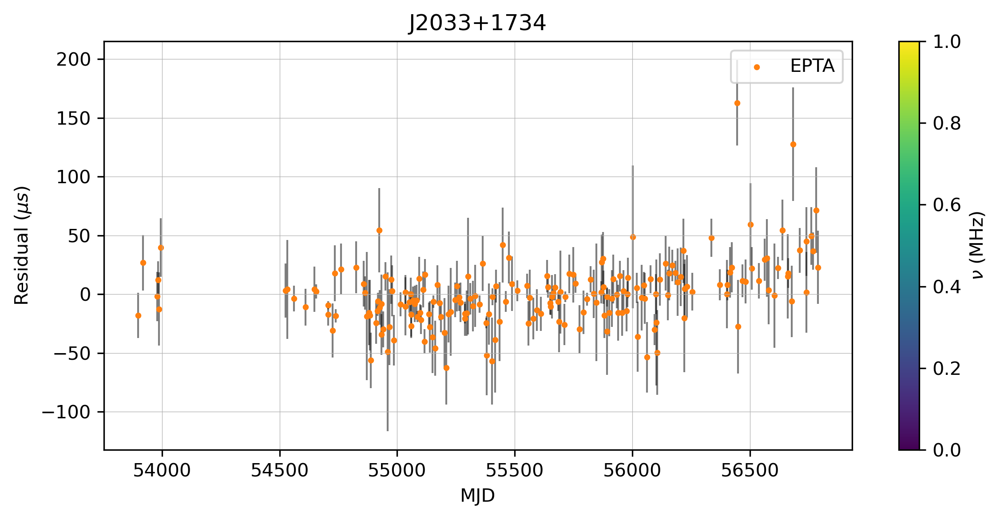

J2124-3358


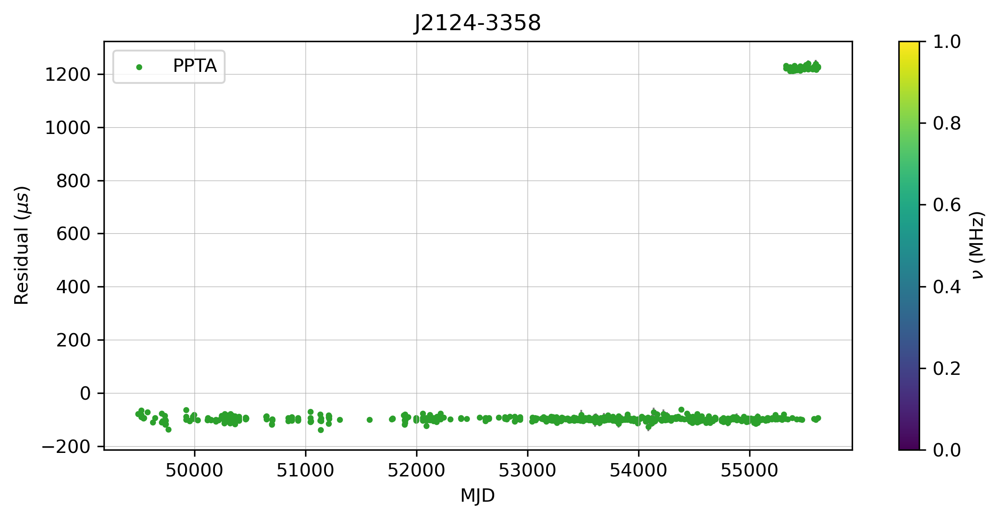

J2129-5721


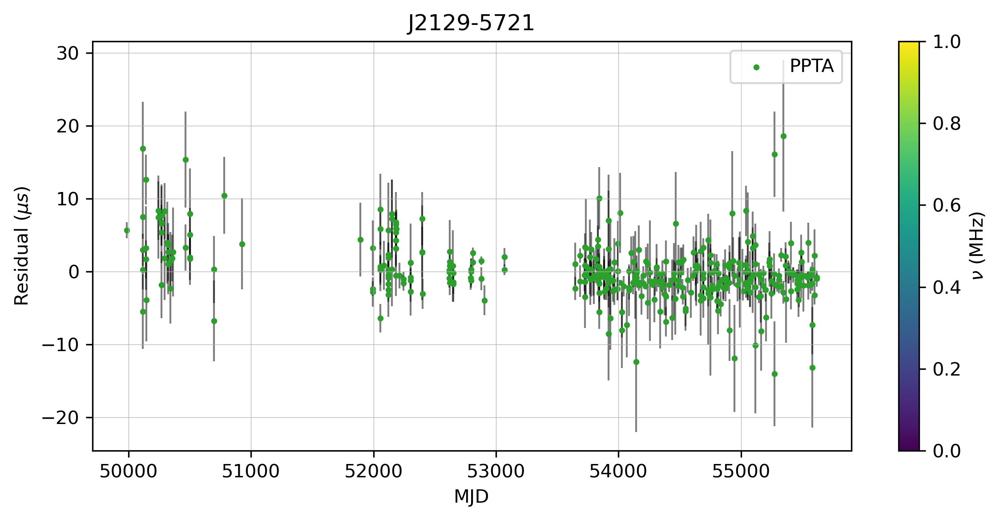

J2145-0750


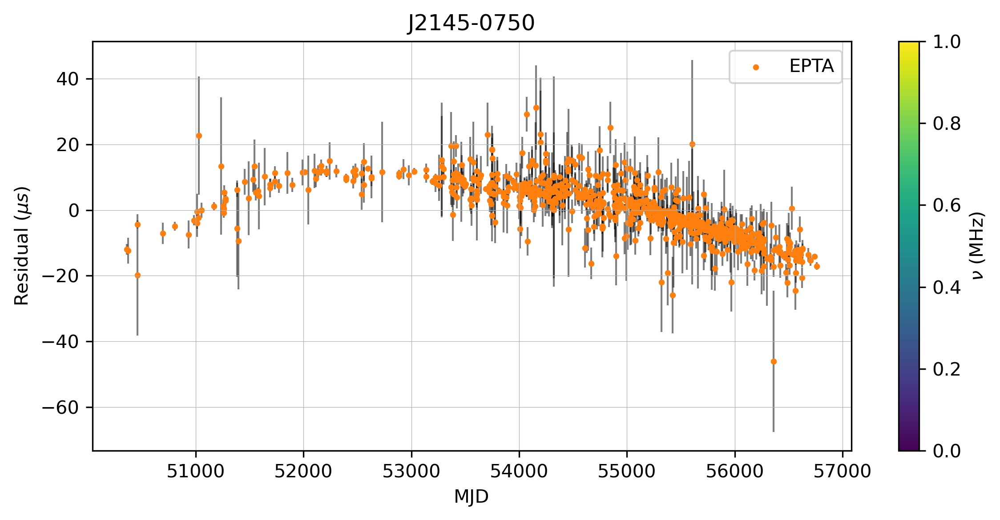

J2229+2643


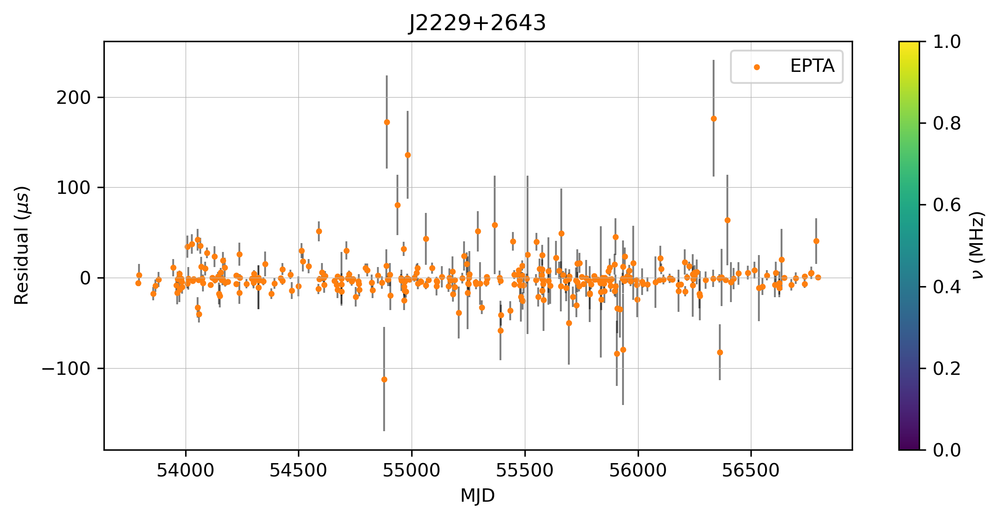

J2317+1439


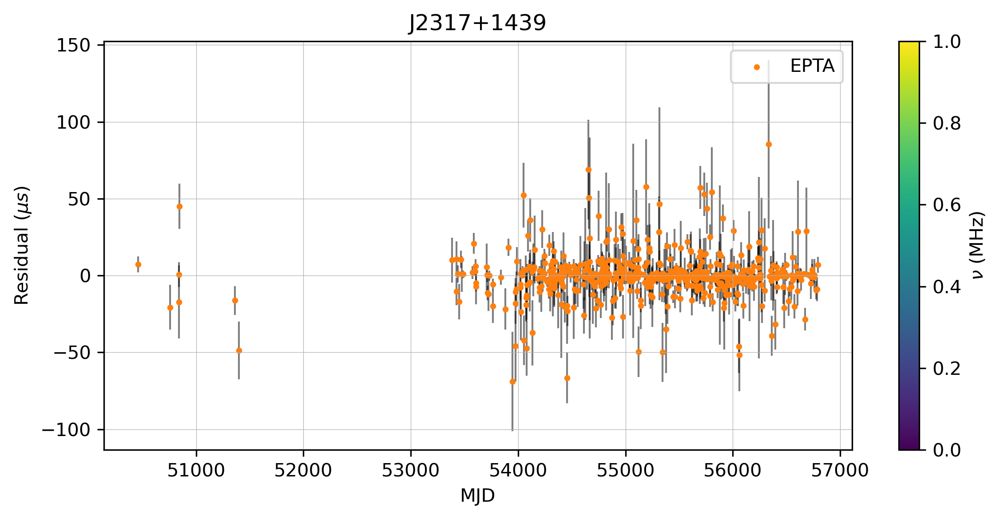

J2322+2057


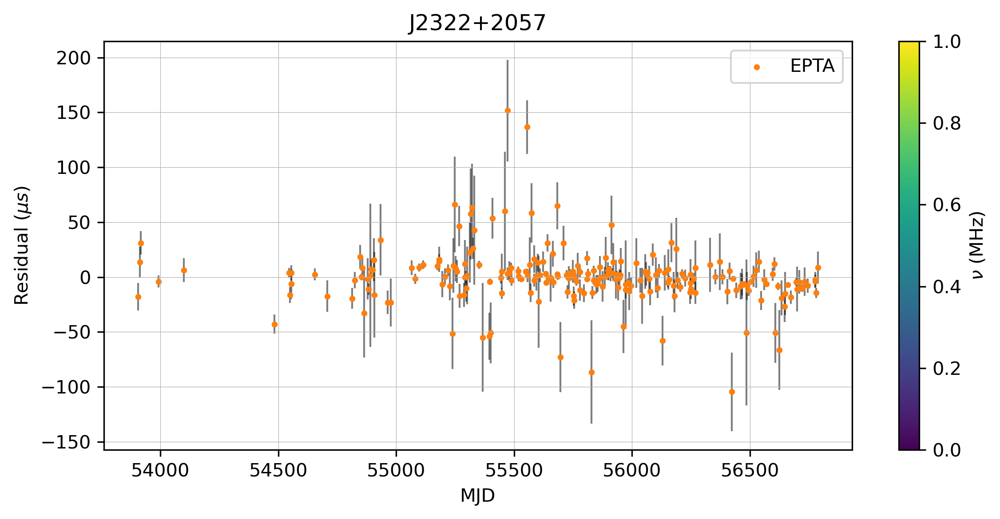

53


In [19]:
psrs = []
T_cut = 3
for psrname in psrlist:
    # load pulsar
    print(psrname)
    parfile = f'{datadir}/{psrname}.par'
    timfile = f'{datadir}/{psrname}.tim'
    psr = Pulsar(parfile, timfile, ephem='DE438')
    # apply 3-year cut
    Tspan = (np.max(psr.toas) - np.min(psr.toas))/const.yr
    if Tspan < T_cut:
        print(f'Cutting {psrname} since Tspan is too short ({Tspan} < {T_cut} yr)')
        continue
    #if not psrname in lite_psrnames:
    #    print(f'Cutting {psrname} since it's not in the original lite_dataset')
    #    continue
    # add to list of pulsars, save and make resids plot
    psr.to_pickle(savedir)
    #try:
    #    psr.to_hdf5(f'{savedir}/{psrname}.hdf5')
    #except:
    #    print('hdf5 failed: save to pickle instead')
    #    psr.to_pickle(savedir)
    plot_resids_bypta(psr)
    psrs.append(psr)
print(len(psrs))

In [20]:
# get Tspan
min_toa = np.min([np.min(psr.toas) for psr in psrs])
max_toa = np.max([np.max(psr.toas) for psr in psrs])
Tspan = max_toa - min_toa
print(f'Tspan in seconds = {Tspan}')
print(f'Tspan in years = {Tspan/const.yr}')

Tspan in seconds = 952746385.6296968
Tspan in years = 30.190711132332524


In [21]:
savedir

'/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis/data/lite_unfiltered_53_ePSRs'

In [22]:
pfiles = glob.glob(f'{savedir}/J*.pkl')
psrs = []
for file in pfiles:
    with open(file, 'rb') as f:
        psrs.append(pickle.load(f))
len(psrs)

53

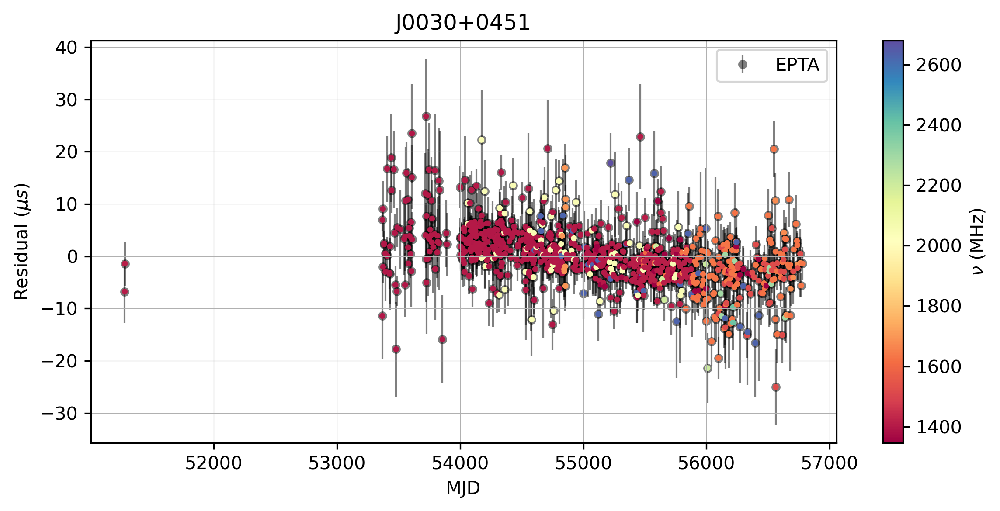

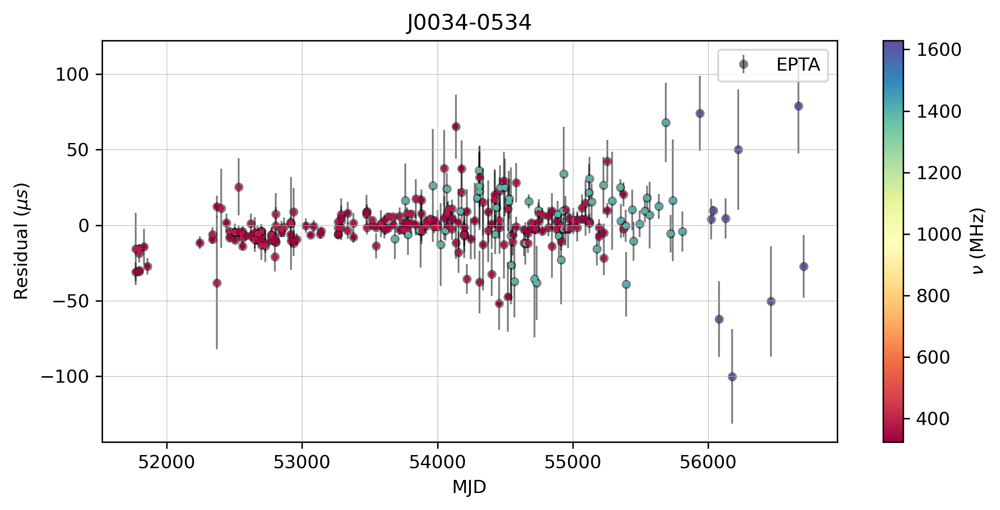

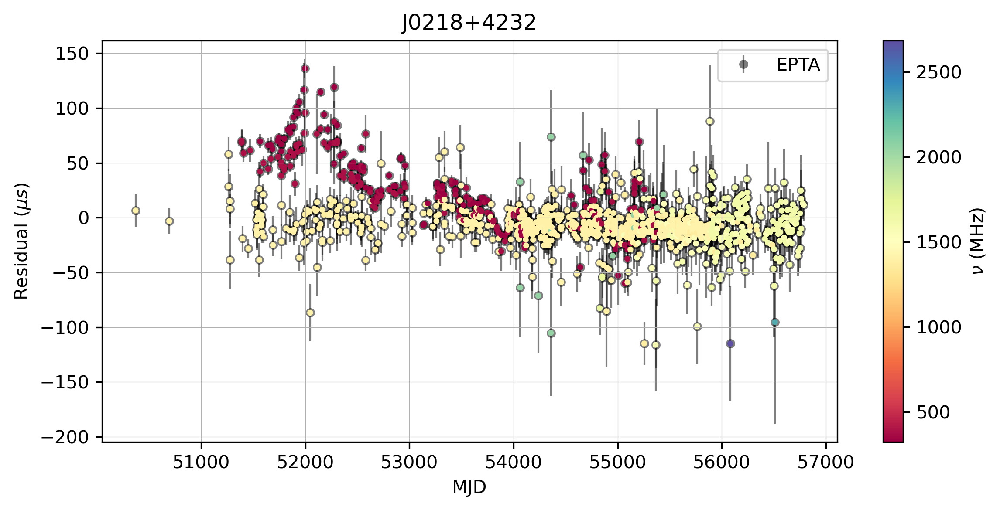

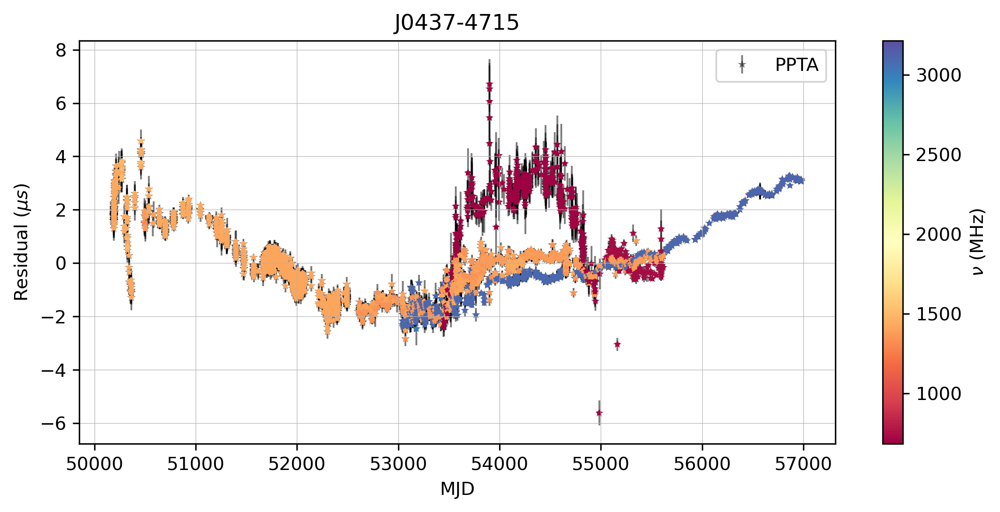

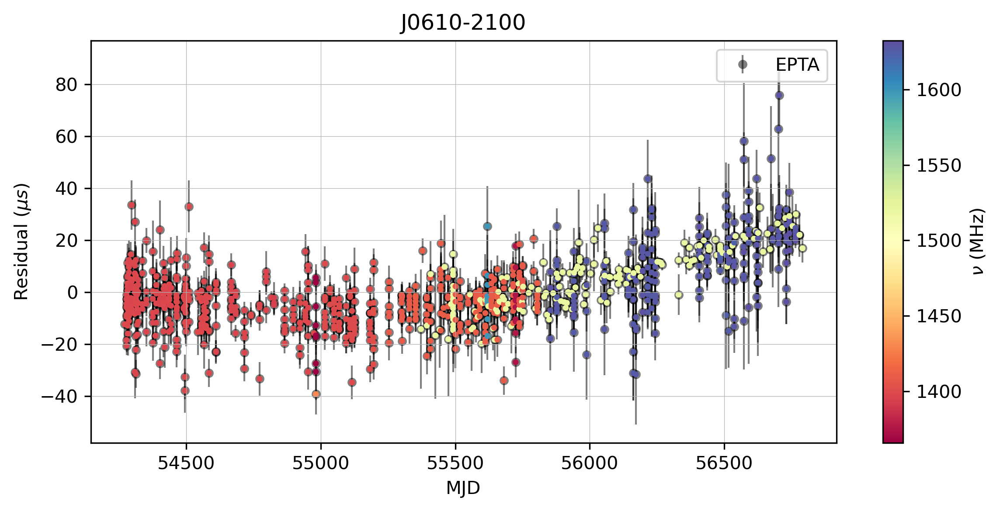

...

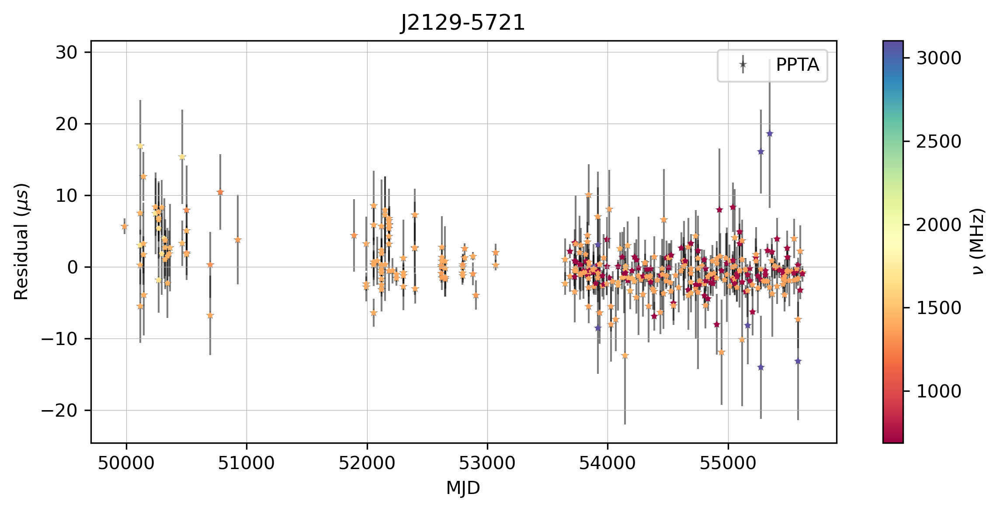

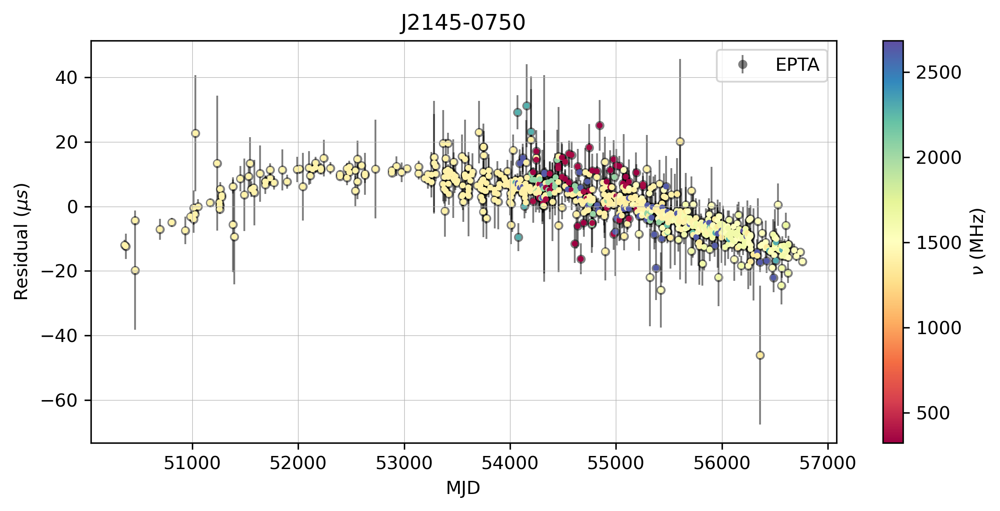

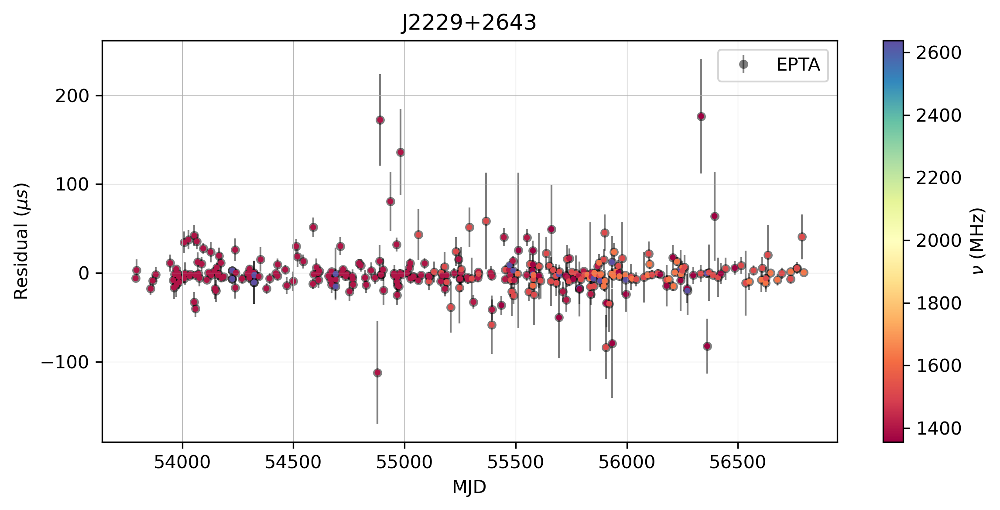

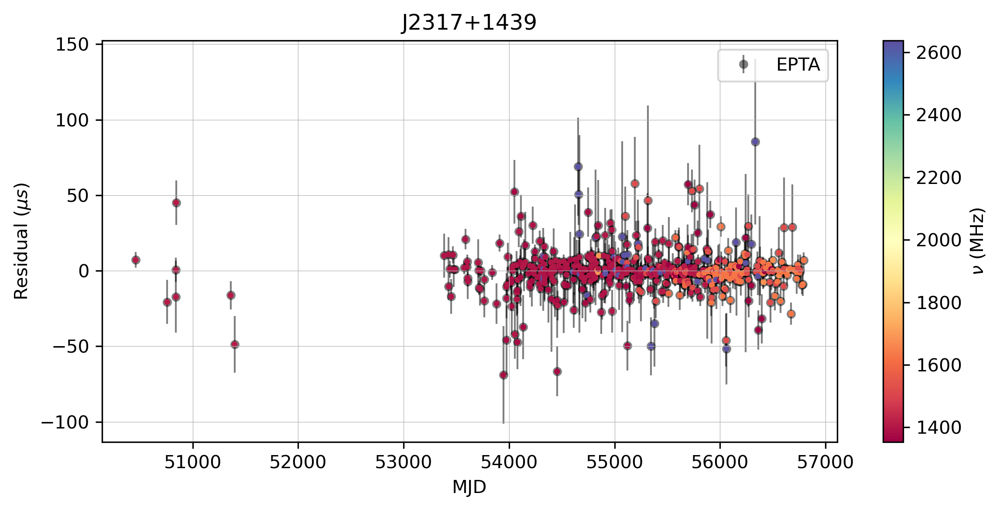

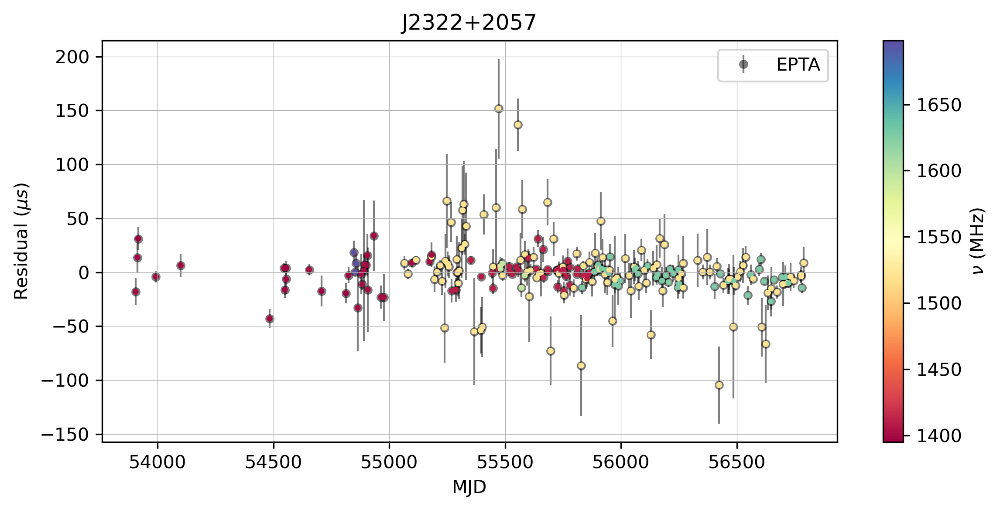

In [23]:
for psr in psrs:
    plot_resids(psr, save=figsave)

In [25]:
savedir

'/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis/data/lite_unfiltered_53_ePSRs'

In [27]:
# get pulsars with 3 < T < 7 
pfiles = glob.glob(f'{savedir.replace("53","43")}/J*.pkl')
psrs_43_names = []
for file in pfiles:
    with open(file, 'rb') as f:
        psr_43 = pickle.load(f)
        psrs_43_names.append(psr_43.name)
print(len(psrs_43_names))
count = 0

for psr in psrs:
    T_yr = (psr.toas.max() - psr.toas.min())/const.yr
    if not psr.name in psrs_43_names:#(T_yr > 3)*(T_yr < 7):
        print(psr.name)#, T_yr)
        count += 1
count

43
J0610-2100
J0900-3144
J1614-2230
J1721-2457
J1741+1351
J1824-2452A
J1903+0327
J1944+0907
J2019+2425
J2033+1734


10

In [30]:
# get first MJD of lite
lite_tmin = np.min([np.min(psr.toas) for psr in lite_psrs])
lite_tmin/const.day

NameError: name 'lite_psrs' is not defined

In [9]:
def plot_all_toas(psrs, save=None, tmin=None):
    fig, ax = plt.subplots(len(psrs),1,figsize=(8,len(psrs)),sharex=True,sharey=True)
    for i, psr in enumerate(psrs):
        for marker, pta, color in zip(['s','o','*'], ['NANOGrav','EPTA','PPTA'], ['C1','C0','C2']):
            if pta in psr.flags['pta']:
                mask = psr.flags['pta'] == pta
                ax[i].scatter(psr.toas[mask]/const.day, psr.freqs[mask], s=5, marker=marker,
                              c=color, label=f'PSR {psr.name} | {pta}')
        ax[i].set_ylabel(r"$\nu$ (MHz)")
        ax[i].grid(linewidth=0.3)
        ax[i].legend(loc='upper left', fontsize='small')
        if tmin:
            ax[i].axvline(tmin/const.day, color='k', ls='--')
    ax[-1].set_xlabel("MJD")
    fig.tight_layout()
    fig.subplots_adjust(hspace=0)
    if save:
        fig.savefig(f'{figsave}/psrs_all.png', dpi=300, bbox_inches='tight')
    plt.show()

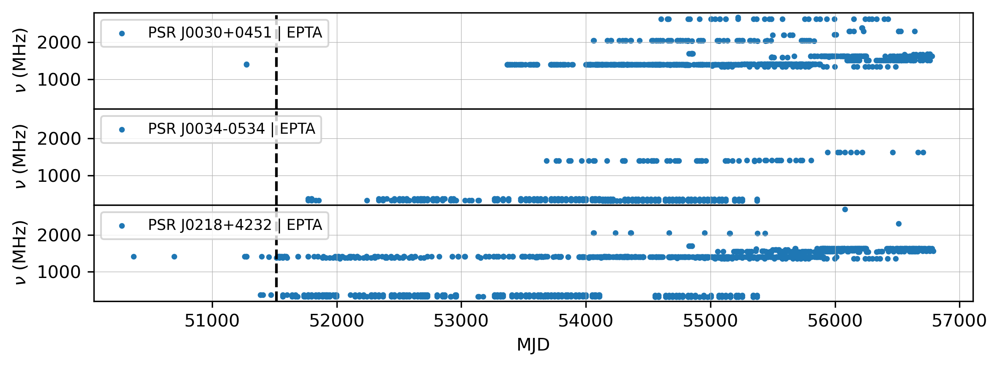

In [52]:
plot_all_toas(psrs[:3], tmin=lite_tmin)#, save=figsave)

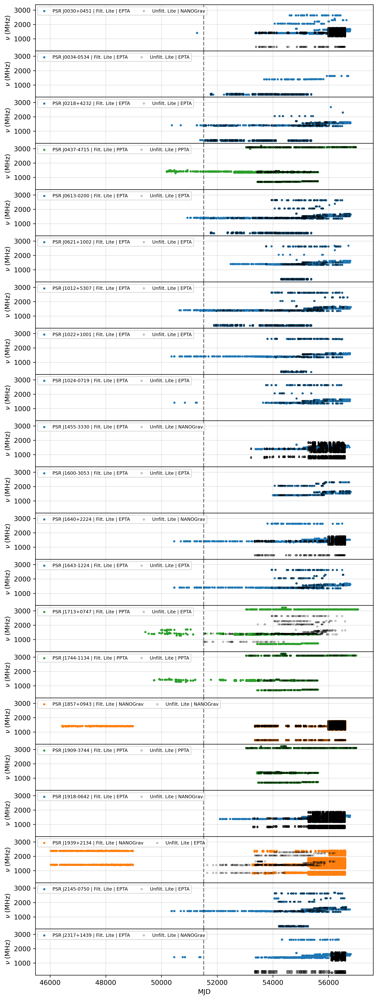

In [33]:
# let's compare the old and new lite dataset
fig, ax = plt.subplots(len(psrs),1,figsize=(8,len(psrs)),sharex=True,sharey=True)
for i, psr in enumerate(psrs):
    for pta, color in zip(['NANOGrav','EPTA','PPTA'], ['C1','C0','C2']):
        if pta in psr.flags['pta']:
            mask = psr.flags['pta'] == pta
            ax[i].scatter(psr.toas[mask]/const.day, psr.freqs[mask], s=5, marker='o',
                          c=color, label=f'PSR {psr.name} | Filt. Lite | {pta}')
    lite_psr = lite_psrs[i]
    lite_pta = np.unique(lite_psr.flags['pta'])[0]
    ax[i].scatter(lite_psr.toas/const.day, lite_psr.freqs, s=5, marker='o',
                  facecolors='none', edgecolors='k', lw=0.3, label=f'Unfilt. Lite | {lite_pta}')
    ax[i].set_ylabel(r"$\nu$ (MHz)")
    ax[i].grid(linewidth=0.3)
    ax[i].legend(loc='upper left', fontsize='x-small', ncol=2)
    ax[i].axvline(lite_tmin/const.day, color='k', ls='--', alpha=0.5)
ax[-1].set_xlabel("MJD")
fig.tight_layout()
fig.subplots_adjust(hspace=0)
plt.show()

## Make "lite-combined" dataset

Copy DR2full pulsars over to new directory? Or apply multifrequency cuts, etc?